## Тюнінг з Optuna, максимізація AUC

In [4]:
import numpy as np 
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
df_train_fe = pd.read_parquet('df_train_fe', engine='pyarrow')
df_train_dpi = pd.read_parquet('df_train_dpi', engine='pyarrow')

In [6]:
# # DPI DPI DPI DPI DPI DPI DPI DPI DPI DPI DPI DPI DPI DPI DPI DPI 
# # Нові фічі 2500+: кількість взаємодії з кожним застосунком усі метрики (600 ознак на кожну)

def create_application_features(df_dpi, df_fe):
    #pivot_count = df_dpi.pivot_table(index='abon_id', columns='Application', values='SUM_of_Count_events', aggfunc='sum', fill_value=0).reset_index()
    pivot_duration = df_dpi.pivot_table(index='abon_id', columns='Application', values='SUM_of_Duration_sec', aggfunc='sum', fill_value=0).reset_index()
    #pivot_volume = df_dpi.pivot_table(index='abon_id', columns='Application', values='SUM_of_Volume_kb', aggfunc='sum', fill_value=0).reset_index()
    #pivot_day_cnt = df_dpi.pivot_table(index='abon_id', columns='Application', values='MAX_of_day_cnt', aggfunc='max', fill_value=0).reset_index()
    
    #pivot_count = pivot_count.add_suffix('_count')
    pivot_duration = pivot_duration.add_suffix('_duration')
    #pivot_volume = pivot_volume.add_suffix('_volume')
    #pivot_day_cnt = pivot_day_cnt.add_suffix('_day_cnt')
    
    #pivot_count.rename(columns={'abon_id_count': 'abon_id'}, inplace=True)
    pivot_duration.rename(columns={'abon_id_duration': 'abon_id'}, inplace=True)
    #pivot_volume.rename(columns={'abon_id_volume': 'abon_id'}, inplace=True)
    #pivot_day_cnt.rename(columns={'abon_id_day_cnt': 'abon_id'}, inplace=True)
    
    #df_fe = df_fe.merge(pivot_count, on='abon_id', how='left')
    df_fe = df_fe.merge(pivot_duration, on='abon_id', how='left')
    #df_fe = df_fe.merge(pivot_volume, on='abon_id', how='left')
    #df_fe = df_fe.merge(pivot_day_cnt, on='abon_id', how='left')
    
    df_fe.fillna(0, inplace=True)
    
    return df_fe

df_train_fe = create_application_features(df_train_dpi, df_train_fe)

In [5]:
df_train_fe

,Ama_rchrgmnt_sum_max_mnt1,content_clc_mea_mnt1,content_cnt_max_mnt1,voice_out_short_part_max_mnt1,voice_mts_in_nrest_part_std_mnt1,num_act_days_max_mnt1,sms_roam_clc_min_mnt1,voice_in_cmpttrs_avg_durmin_mnt1,com_num_part_mea_mnt1,pay_avg_mea_mnt1,...,2563_duration,2564_duration,2568_duration,2569_duration,2571_duration,2573_duration,2574_duration,2575_duration,2577_duration,2578_duration
0,0,0.0,13.841608,1.480453,0.000000,5.324077,0,19.049712,1.657608,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0
1,0,0.0,11.361162,1.000313,1.000007,5.324077,0,0.000000,1.001037,15.014574,...,0.0,0.0,0.000000,4.786566,0.0,0.0,0.0,0.0,0.000000,0.0
2,0,0.0,10.269117,0.000000,0.000000,5.324077,0,0.000000,1.015666,11.615193,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0
3,0,0.0,9.974412,1.033241,1.000128,5.324077,0,0.000000,1.002645,11.615193,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0
4,0,0.0,6.749902,1.000641,1.000548,5.324077,0,28.858494,1.048314,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149995,0,0.0,8.333536,1.010017,1.001535,5.324077,0,0.000000,1.335142,14.327306,...,0.0,0.0,24.078618,2.206949,0.0,0.0,0.0,0.0,28.024371,0.0
149996,0,0.0,14.038728,1.006078,1.066591,5.324077,0,0.000000,1.208153,12.792268,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0
149997,0,0.0,13.225565,1.000865,1.000887,5.324077,0,0.000000,1.037025,2.206949,...,0.0,0.0,136.602691,148.761937,0.0,0.0,0.0,0.0,40.372638,0.0
149998,0,0.0,19.524976,1.001231,0.000000,5.324077,0,15.464618,1.276047,9.110034,...,0.0,0.0,14.790617,40.837996,0.0,0.0,0.0,0.0,0.000000,0.0


In [7]:
features_2_use = ['target','loc_market_share', 'voice_in_td_cnt_mea_mnt1', 'lt',
       'device_days_usage', 'sms_in_cnt_std_mnt3', 'Balance_uah',
       'all_cnt_std_mnt3', 'days_of_end_last_ppm',
       'conn_out_uniq_cnt_mea_mnt1', 'num_act_days_mea_mnt3',
       'imei_mean_long_days_usage', 'all_cnt_std_mnt1',
       'all_cnt_max_mnt1', 'day_end_gba', 'imei_mean_days_usage',
       'data_3g_tv_cnt_std_mnt1', 'voice_out_tar_dur_min_mnt3',
       '690_duration', '246_duration', 'days_of_last_ppm', '678_duration',
       'num_act_days_mea_mnt1', '850_duration', '175_duration',
       'num_act_days_min_mnt3', '933_duration', '257_duration',
       'loc_is_obl_center', '240_duration', '964_duration',
       '882_duration', '272_duration', '254_duration', '877_duration',
       '897_duration', '381_duration', '2018_duration', '677_duration',
       '1414_duration', '992_duration']

In [8]:
df_train_fe = df_train_fe[features_2_use]

In [8]:
df_train_fe

,target,loc_market_share,voice_in_td_cnt_mea_mnt1,lt,device_days_usage,sms_in_cnt_std_mnt3,Balance_uah,all_cnt_std_mnt3,days_of_end_last_ppm,conn_out_uniq_cnt_mea_mnt1,...,882_duration,272_duration,254_duration,877_duration,897_duration,381_duration,2018_duration,677_duration,1414_duration,992_duration
0,0,1.186492,2.569415,6.135202,53.249600,1.480453,22.318415,6.987345,-8.687248,1.657608,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0,1.186492,15.945794,6.135617,47.044200,2.167550,8.941571,15.923826,-12.103587,11.166001,...,35.613482,0.000000,127.299486,81.675120,0.000000,66.419865,0.000000,86.182867,0.000000,0.000000
2,0,1.134741,5.193046,6.125043,27.615852,1.928700,7.968935,8.412559,-9.974412,3.427815,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0,1.186492,11.862541,6.130697,34.201236,1.734972,15.785645,8.318161,-9.974412,4.786566,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0,1.186492,11.739678,6.117506,50.270526,1.412204,10.155084,9.234726,28.024371,6.640177,...,30.091218,49.045301,141.779151,72.445568,82.907731,100.965046,22.835329,132.223815,64.035903,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149995,0,1.063584,14.607832,3.435160,15.490679,2.498626,14.566247,19.227873,-13.011325,8.943369,...,86.655523,0.000000,134.726506,75.963939,84.158019,74.056924,7.174761,167.997614,188.496777,0.000000
149996,0,1.063584,7.773994,3.317906,14.232033,1.696520,1.480454,15.492986,-9.974412,2.747039,...,45.549770,54.502683,166.127309,76.649633,13.841608,133.639159,35.147011,110.836636,204.292682,0.000000
149997,0,1.063584,15.233725,3.353751,13.225565,5.621507,1.033302,20.939140,4.786566,7.277660,...,92.995807,8.333536,182.637497,125.217182,98.890091,214.523261,45.883305,158.881633,211.523137,0.000000
149998,0,1.063584,12.680856,3.450216,15.658495,6.897875,3.591707,22.499208,-10.269117,10.484021,...,53.918053,36.594907,132.103391,85.256965,153.618361,82.347789,35.905444,131.760625,72.358808,75.250233


In [ ]:
# !!!! ДУЖЕ ВЕЛИКИЙ ЧАС РОБОТИ КОДУ - ВІД 10 до 20 годин

import pandas as pd
import numpy as np
import optuna
import lightgbm as lgb
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import roc_auc_score, f1_score, classification_report, confusion_matrix
import warnings
import pickle

warnings.filterwarnings('ignore')

X = df_train_fe.drop(columns=['target'])
y = df_train_fe['target']

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Функція для оптимізації
def objective(trial):
    params = {
        'objective': 'binary',
        'metric': 'auc',
        'is_unbalance': True,
        'boosting_type': trial.suggest_categorical('boosting_type', ['gbdt', 'dart']),
        'num_leaves': trial.suggest_int('num_leaves', 20, 150),
        'max_depth': trial.suggest_int('max_depth', 5, 30),
        'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 0.1),
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 0.1, 10),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 0.1, 10),
        'min_split_gain': trial.suggest_loguniform('min_split_gain', 0.01, 0.1),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0)
    }
    
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    train_auc_scores = []
    valid_auc_scores = []

    for train_idx, valid_idx in cv.split(X_train, y_train):
        X_train_cv, X_valid_cv = X_train.iloc[train_idx], X_train.iloc[valid_idx]
        y_train_cv, y_valid_cv = y_train.iloc[train_idx], y_train.iloc[valid_idx]

        model = lgb.LGBMClassifier(**params, verbose=-1)
        model.fit(X_train_cv, y_train_cv, eval_set=[(X_valid_cv, y_valid_cv)])
        
        train_preds = model.predict_proba(X_train_cv)[:, 1]
        valid_preds = model.predict_proba(X_valid_cv)[:, 1]
        
        train_auc = roc_auc_score(y_train_cv, train_preds)
        valid_auc = roc_auc_score(y_valid_cv, valid_preds)
        
        train_auc_scores.append(train_auc)
        valid_auc_scores.append(valid_auc)

    mean_train_auc = np.mean(train_auc_scores)
    mean_valid_auc = np.mean(valid_auc_scores)
    #alphah = 0.5
    #alphah = 2
    #return alphah * (mean_train_auc - mean_valid_auc) - (1 - alphah) * mean_valid_auc
    #return mean_train_auc - mean_valid_auc
    return - mean_valid_auc

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)

best_params = study.best_params
best_params['objective'] = 'binary'
best_params['metric'] = 'auc'
best_params['is_unbalance'] = True

best_model = lgb.LGBMClassifier(**best_params)
best_model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)])

train_preds = best_model.predict_proba(X_train)[:, 1]
valid_preds = best_model.predict_proba(X_valid)[:, 1]

train_auc = roc_auc_score(y_train, train_preds)
valid_auc = roc_auc_score(y_valid, valid_preds)

print(f"Train AUC: {train_auc}")
print(f"Validation AUC: {valid_auc}")

print("Best parameters found by Optuna:")
for param, value in best_params.items():
    print(f"{param}: {value}")

with open('best_model_params_optuna.pkl', 'wb') as f:
    pickle.dump(best_params, f)

model_filename = 'best_model_optuna.pkl'
with open(model_filename, 'wb') as file:
    pickle.dump(best_model, file)

## Тюнінг з Optuna, мінімізація (Train AUC - Validation Auc)

In [ ]:
# !!!! ДУЖЕ ВЕЛИКИЙ ЧАС РОБОТИ КОДУ - ВІД 10 до 20 годин

import pandas as pd
import numpy as np
import optuna
import lightgbm as lgb
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import roc_auc_score, f1_score, classification_report, confusion_matrix
import warnings
import pickle

warnings.filterwarnings('ignore')

X = df_train_fe.drop(columns=['target'])
y = df_train_fe['target']

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Функція для оптимізації
def objective(trial):
    params = {
        'objective': 'binary',
        'metric': 'auc',
        'is_unbalance': True,
        'boosting_type': trial.suggest_categorical('boosting_type', ['gbdt', 'dart']),
        'num_leaves': trial.suggest_int('num_leaves', 20, 150),
        'max_depth': trial.suggest_int('max_depth', 5, 30),
        'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 0.1),
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 0.1, 10),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 0.1, 10),
        'min_split_gain': trial.suggest_loguniform('min_split_gain', 0.01, 0.1),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0)
    }
    
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    train_auc_scores = []
    valid_auc_scores = []

    for train_idx, valid_idx in cv.split(X_train, y_train):
        X_train_cv, X_valid_cv = X_train.iloc[train_idx], X_train.iloc[valid_idx]
        y_train_cv, y_valid_cv = y_train.iloc[train_idx], y_train.iloc[valid_idx]

        model = lgb.LGBMClassifier(**params, verbose=-1)
        model.fit(X_train_cv, y_train_cv, eval_set=[(X_valid_cv, y_valid_cv)])
        
        train_preds = model.predict_proba(X_train_cv)[:, 1]
        valid_preds = model.predict_proba(X_valid_cv)[:, 1]
        
        train_auc = roc_auc_score(y_train_cv, train_preds)
        valid_auc = roc_auc_score(y_valid_cv, valid_preds)
        
        train_auc_scores.append(train_auc)
        valid_auc_scores.append(valid_auc)

    mean_train_auc = np.mean(train_auc_scores)
    mean_valid_auc = np.mean(valid_auc_scores)
    #alphah = 0.5
    #alphah = 2
    #return alphah * (mean_train_auc - mean_valid_auc) - (1 - alphah) * mean_valid_auc
    return mean_train_auc - mean_valid_auc
    #return - mean_valid_auc

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)

best_params = study.best_params
best_params['objective'] = 'binary'
best_params['metric'] = 'auc'
best_params['is_unbalance'] = True

best_model = lgb.LGBMClassifier(**best_params)
best_model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)])

train_preds = best_model.predict_proba(X_train)[:, 1]
valid_preds = best_model.predict_proba(X_valid)[:, 1]

train_auc = roc_auc_score(y_train, train_preds)
valid_auc = roc_auc_score(y_valid, valid_preds)

print(f"Train AUC: {train_auc}")
print(f"Validation AUC: {valid_auc}")

# Виведення параметрів найкращої моделі
print("Best parameters found by Optuna:")
for param, value in best_params.items():
    print(f"{param}: {value}")

with open('best_model_params_optuna.pkl', 'wb') as f:
    pickle.dump(best_params, f)

model_filename = 'best_model_optuna.pkl'
with open(model_filename, 'wb') as file:
    pickle.dump(best_model, file)

Беремо в подальшу роботу параметри що відповідають максимізації AUC валідаційного тесту. Параметри що забезпечують мінімальну різницю між метриками на навчальному та валідаційному тесті не забезпечують належний рівень головної метрики, отримані результати мають гірше більш ніж на 4% охоплення цільової групи. 

## Перевірка роботи моделі з підібраними параметрами

[LightGBM] [Info] Number of positive: 7669, number of negative: 112331
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 9061
[LightGBM] [Info] Number of data points in the train set: 120000, number of used features: 40
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.063908 -> initscore=-2.684264
[LightGBM] [Info] Start training from score -2.684264
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
AUC Train: 0.9302
AUC Validation: 0.9019
AUC Difference: 0.0283
Recall: 0.7872
FP/TP Ratio: 2.7482
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.85      0.91     28083
           1       0.27      0.79      0.40      1917

    accuracy                           0.85     30000
   macro avg       0.63   

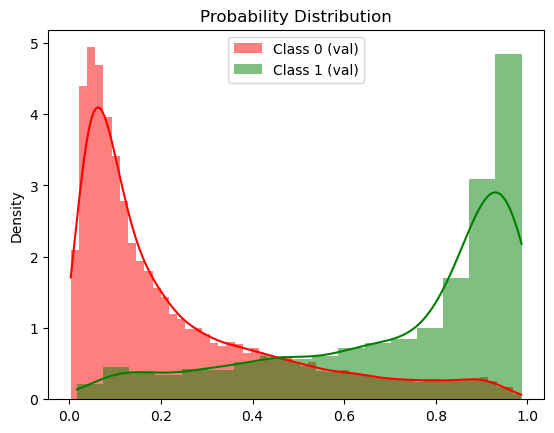

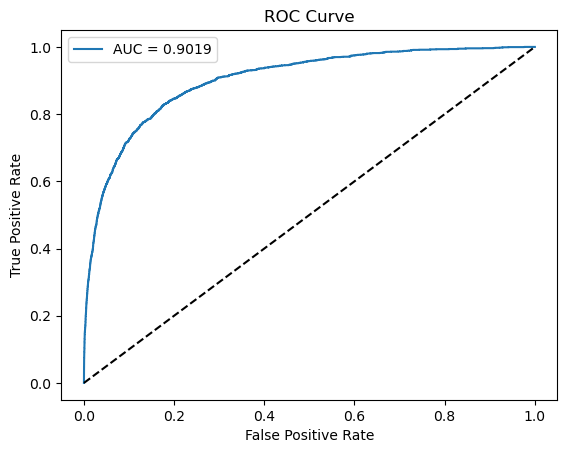

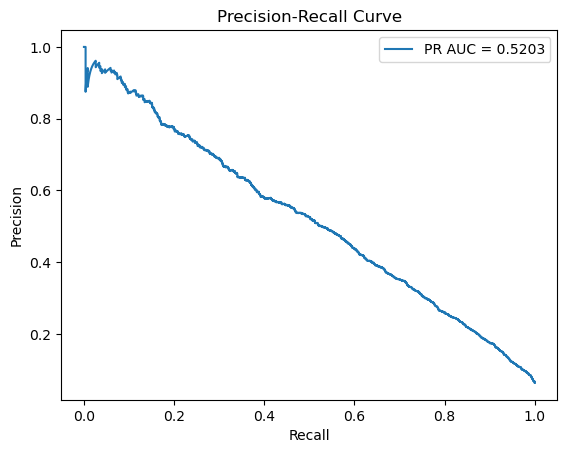

In [9]:
import lightgbm as lgb
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    roc_auc_score, recall_score, confusion_matrix, 
    classification_report, roc_curve, precision_recall_curve, auc
)

params = {
    'boosting_type': 'gbdt',
    'num_leaves': 24,
    'max_depth': 6,
    'learning_rate': 0.010606093313886997,
    'n_estimators': 985,
    'reg_alpha': 9.420645904664145,
    'reg_lambda': 0.10126233266969996,
    'min_split_gain': 0.09655043871672996,
    'subsample': 0.9931456581710266,
    'colsample_bytree': 0.7662855966200249,
    'objective': 'binary',
    'metric': 'auc',
    'is_unbalance': True
}

X = df_train_fe.drop(columns=['target'])
y = df_train_fe['target']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

model = lgb.LGBMClassifier(**params)
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])
    
y_train_pred_prob = model.predict_proba(X_train)[:, 1]
y_val_pred_prob = model.predict_proba(X_val)[:, 1]
y_val_pred = model.predict(X_val)
    
auc_train = roc_auc_score(y_train, y_train_pred_prob)
auc_val = roc_auc_score(y_val, y_val_pred_prob)
auc_diff = auc_train - auc_val
recall = recall_score(y_val, y_val_pred)
cm = confusion_matrix(y_val, y_val_pred)
fp_tp_ratio = cm[0, 1] / cm[1, 1] if cm[1, 1] != 0 else float('inf')
clf_report = classification_report(y_val, y_val_pred)

print(f"AUC Train: {auc_train:.4f}")
print(f"AUC Validation: {auc_val:.4f}")
print(f"AUC Difference: {auc_diff:.4f}")
print(f"Recall: {recall:.4f}")
print(f"FP/TP Ratio: {fp_tp_ratio:.4f}")
print("Classification Report:")
print(clf_report)
print("Confusion Matrix:")
print(cm)
        
sns.histplot(y_val_pred_prob[y_val == 0], color='red', label='Class 0 (val)', kde=True, stat='density', linewidth=0)
sns.histplot(y_val_pred_prob[y_val == 1], color='green', label='Class 1 (val)', kde=True, stat='density', linewidth=0)
plt.title(f'Probability Distribution')
plt.legend()
plt.show()
        
fpr, tpr, _ = roc_curve(y_val, y_val_pred_prob)
plt.plot(fpr, tpr, label=f'AUC = {auc_val:.4f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve')
plt.legend()
plt.show()
        
precision, recall, _ = precision_recall_curve(y_val, y_val_pred_prob)
pr_auc = auc(recall, precision)
plt.plot(recall, precision, label=f'PR AUC = {pr_auc:.4f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title(f'Precision-Recall Curve')
plt.legend()
plt.show()
    
model_filename = 'best_model_auc.pkl'
with open(model_filename, 'wb') as file:
    pickle.dump(model, file)


In [10]:
thresholds = np.arange(0, 1.01, 0.01)
results = []

for threshold in thresholds:
    y_val_pred = (y_val_pred_prob >= threshold).astype(int)
    recall = recall_score(y_val, y_val_pred)
    cm = confusion_matrix(y_val, y_val_pred)
    fp_tp_ratio = cm[0, 1] / cm[1, 1] if cm[1, 1] != 0 else float('inf')
    results.append({
        'Threshold': threshold,
        'Recall': recall,
        'FP/TP Ratio': fp_tp_ratio
    })

results_df = pd.DataFrame(results)
pd.set_option('display.float_format', '{:.4f}'.format)
pd.set_option('display.max_rows', None)
print(results_df)

     Threshold  Recall  FP/TP Ratio
0       0.0000  1.0000      14.6495
1       0.0100  1.0000      14.5493
2       0.0200  0.9995      14.1508
3       0.0300  0.9979      13.5912
4       0.0400  0.9958      12.8869
5       0.0500  0.9937      12.2079
6       0.0600  0.9927      11.4761
7       0.0700  0.9911      10.8053
8       0.0800  0.9859      10.2074
9       0.0900  0.9817       9.6738
10      0.1000  0.9770       9.1997
11      0.1100  0.9708       8.7566
12      0.1200  0.9687       8.3414
13      0.1300  0.9624       8.0076
14      0.1400  0.9583       7.6805
15      0.1500  0.9536       7.4190
16      0.1600  0.9499       7.1455
17      0.1700  0.9457       6.9084
18      0.1800  0.9426       6.6397
19      0.1900  0.9400       6.4312
20      0.2000  0.9364       6.1889
21      0.2100  0.9317       5.9899
22      0.2200  0.9301       5.7813
23      0.2300  0.9264       5.6239
24      0.2400  0.9223       5.4683
25      0.2500  0.9191       5.3036
26      0.2600  0.9155      

In [11]:
import lightgbm as lgb
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    roc_auc_score, recall_score, confusion_matrix, 
    classification_report, roc_curve, precision_recall_curve, auc
)
import pickle

params = {
    'boosting_type': 'gbdt',
    'num_leaves': 24,
    'max_depth': 6,
    'learning_rate': 0.010606093313886997,
    'n_estimators': 985,
    'reg_alpha': 9.420645904664145,
    'reg_lambda': 0.10126233266969996,
    'min_split_gain': 0.09655043871672996,
    'subsample': 0.9931456581710266,
    'colsample_bytree': 0.7662855966200249,
    'objective': 'binary',
    'metric': 'auc',
    'is_unbalance': True,
    'verbose': -1
}

X = df_train_fe.drop(columns=['target'])
y = df_train_fe['target']
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

model = lgb.LGBMClassifier(**params)
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

y_train_pred_prob = model.predict_proba(X_train)[:, 1]
y_val_pred_prob = model.predict_proba(X_val)[:, 1]

threshold = 0.63
y_train_pred = (y_train_pred_prob >= threshold).astype(int)
y_val_pred = (y_val_pred_prob >= threshold).astype(int)

auc_train = roc_auc_score(y_train, y_train_pred_prob)
auc_val = roc_auc_score(y_val, y_val_pred_prob)
auc_diff = auc_train - auc_val
recall = recall_score(y_val, y_val_pred)
cm = confusion_matrix(y_val, y_val_pred)
fp_tp_ratio = cm[0, 1] / cm[1, 1] if cm[1, 1] != 0 else float('inf')
clf_report = classification_report(y_val, y_val_pred)

print(f"AUC Train: {auc_train:.4f}")
print(f"AUC Validation: {auc_val:.4f}")
print(f"AUC Difference: {auc_diff:.4f}")
print(f"Recall: {recall:.4f}")
print(f"FP/TP Ratio: {fp_tp_ratio:.4f}")
print("Classification Report:")
print(clf_report)
print("Confusion Matrix:")
print(cm)

AUC Train: 0.9302
AUC Validation: 0.9019
AUC Difference: 0.0283
Recall: 0.7136
FP/TP Ratio: 1.9094
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.91      0.94     28083
           1       0.34      0.71      0.46      1917

    accuracy                           0.89     30000
   macro avg       0.66      0.81      0.70     30000
weighted avg       0.94      0.89      0.91     30000

Confusion Matrix:
[[25471  2612]
 [  549  1368]]


## Зміст ознак, SHAP, кореляція

In [12]:
feature_importances = model.feature_importances_
features = X_train.columns

feature_importance_df = pd.DataFrame({
    'feature': features,
    'importance': feature_importances
}).sort_values(by='importance', ascending=False)

def compute_feature_stats(df, feature):
    total_rows = len(df)
    missing_count = df[feature].isnull().sum()
    unique_values_count = df[feature].nunique()
    return missing_count, unique_values_count

results = []

for feature in feature_importance_df['feature']:
    missing_count, unique_values_count = compute_feature_stats(df_train_fe, feature)
    results.append({
        'feature': feature,
        'missing_count': missing_count,
        'unique_values_count': unique_values_count,
        'importance': feature_importance_df.loc[feature_importance_df['feature'] == feature, 'importance'].values[0]
    })

feature_stats_df = pd.DataFrame(results)
feature_stats_df = feature_stats_df.sort_values(by='importance', ascending=False).drop(columns='importance')
pd.set_option('display.max_rows', None)
print(feature_stats_df)

                       feature  missing_count  unique_values_count
0             loc_market_share              0                   26
1                           lt              0                 7581
2     voice_in_td_cnt_mea_mnt1              0                  895
3            device_days_usage              0                 4254
4                  Balance_uah              0               137988
5          sms_in_cnt_std_mnt3              0                 9305
6             all_cnt_std_mnt3              0                88362
7         days_of_end_last_ppm              0                 1257
8         imei_mean_days_usage              0                50808
9        num_act_days_mea_mnt3              0                   85
10  conn_out_uniq_cnt_mea_mnt1              0                  407
11                240_duration              0                49030
12                 day_end_gba              0                  365
13            all_cnt_std_mnt1              0                2

100%|===================| 119997/120000 [45:36<00:00]        

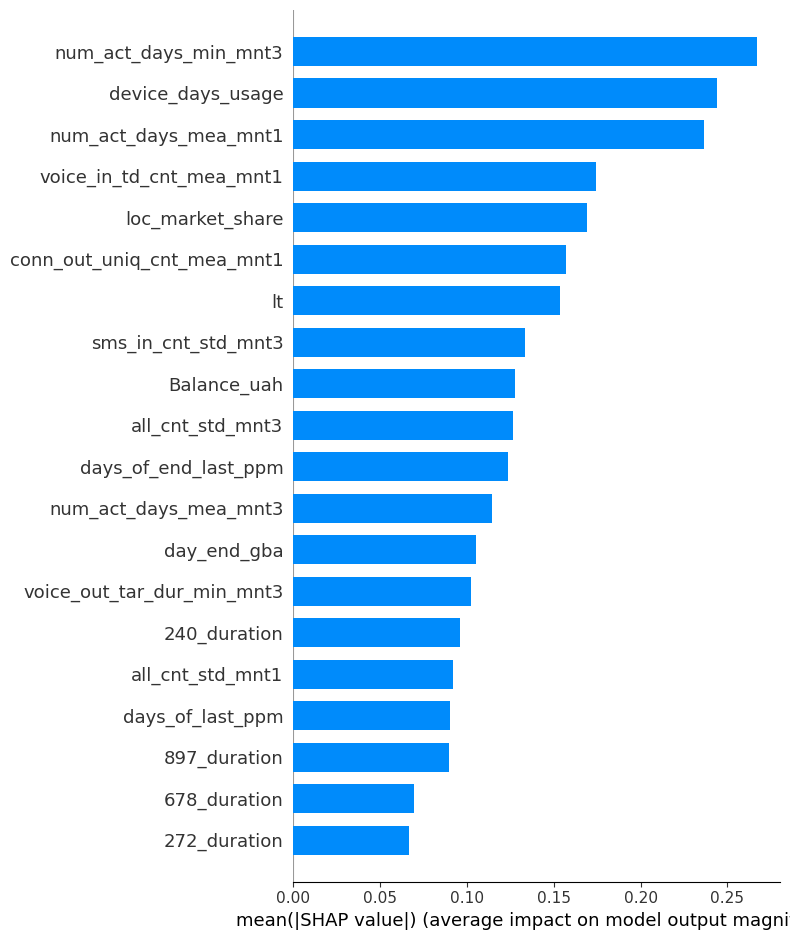

In [35]:
import shap
explainer = shap.Explainer(model, X_train)
shap_values = explainer(X_train, check_additivity=False)

shap.summary_plot(shap_values, X_train, plot_type='bar')

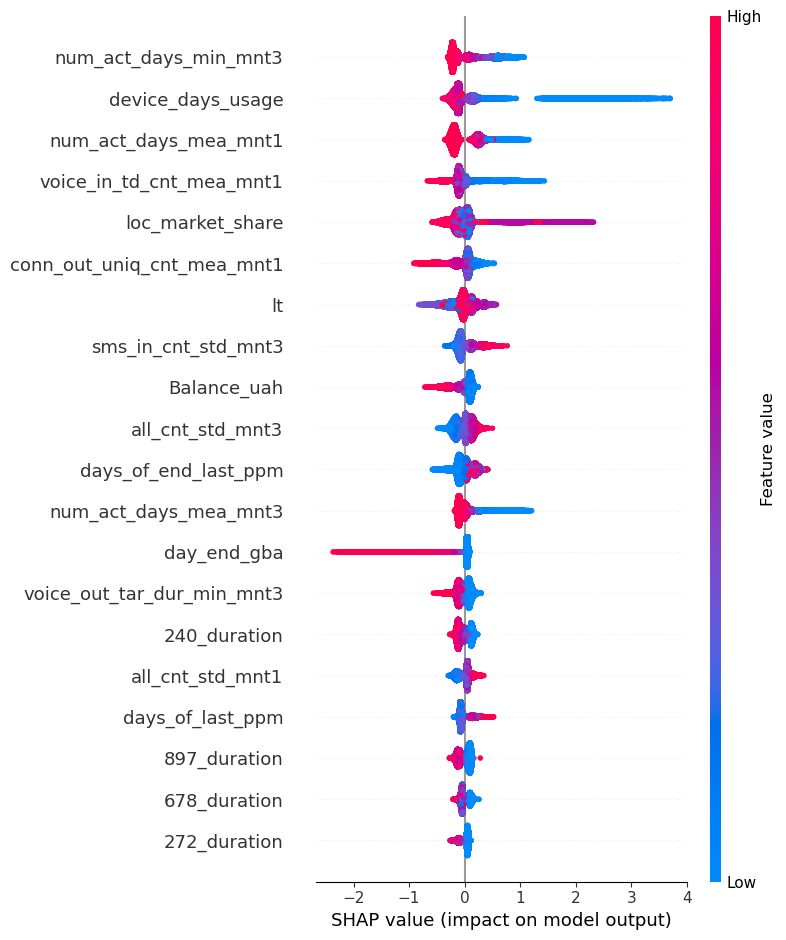

In [27]:
plt.figure(figsize=(20, 10))
shap.summary_plot(shap_values, X_train, plot_type="dot")

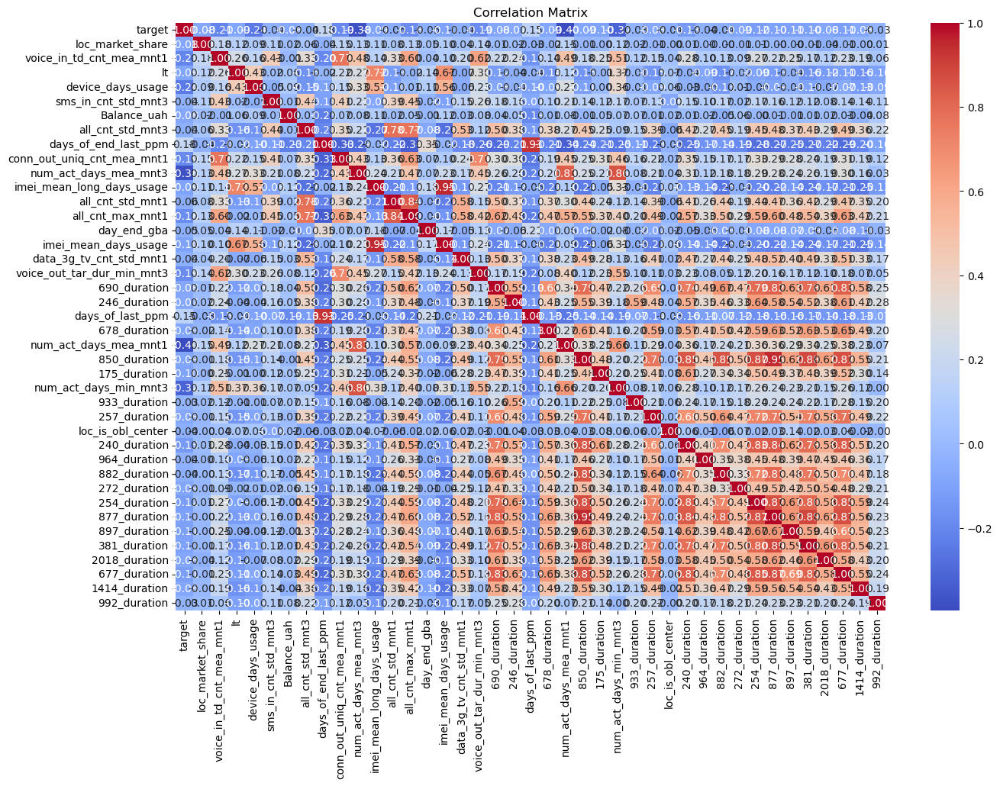

In [18]:
correlation_matrix = df_train_fe.corr()

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

## Розподіли значень, гістограми та боксплот

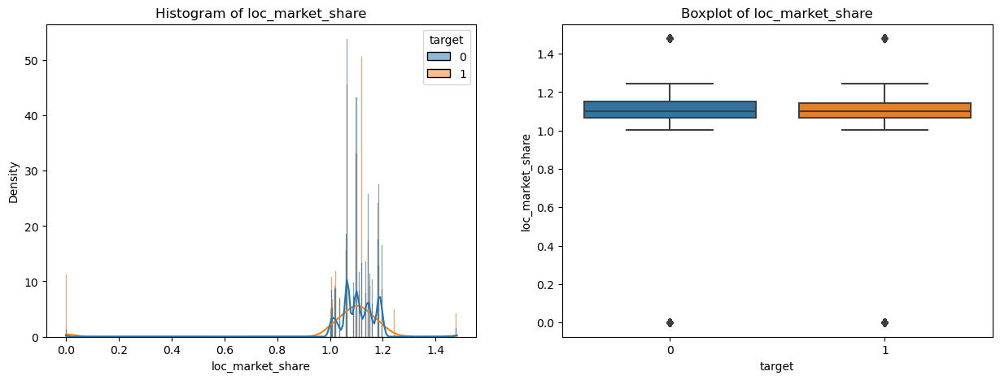

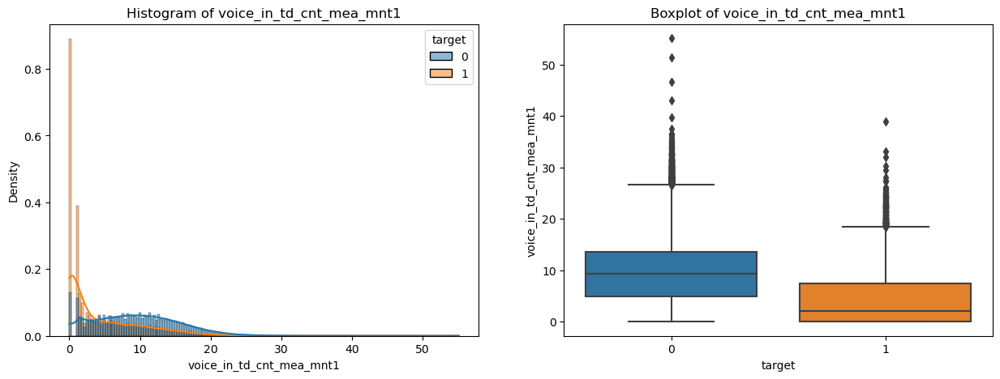

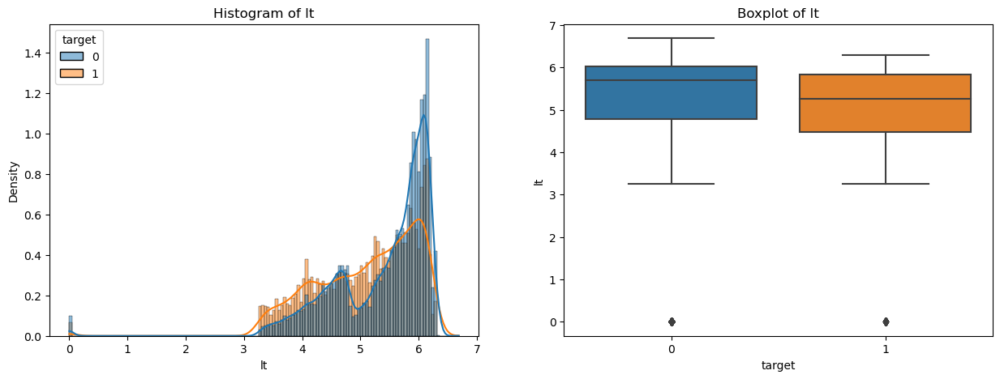

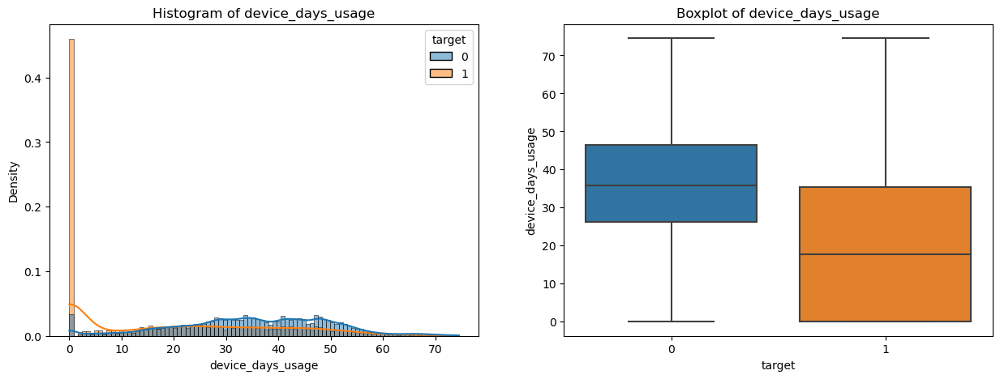

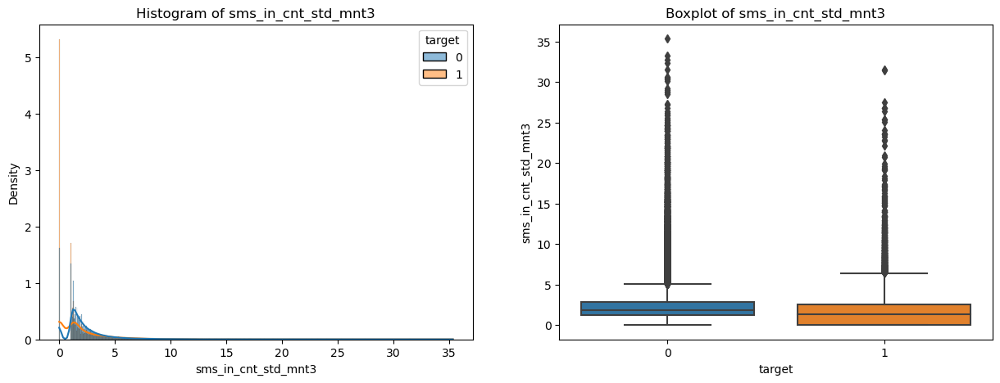

...

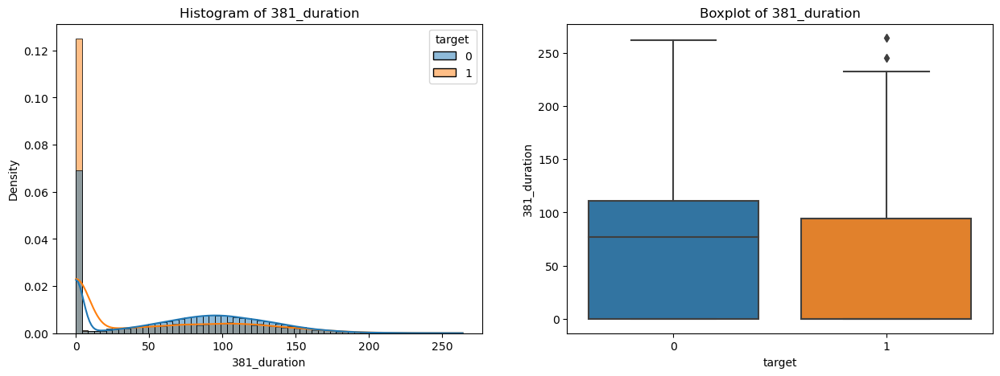

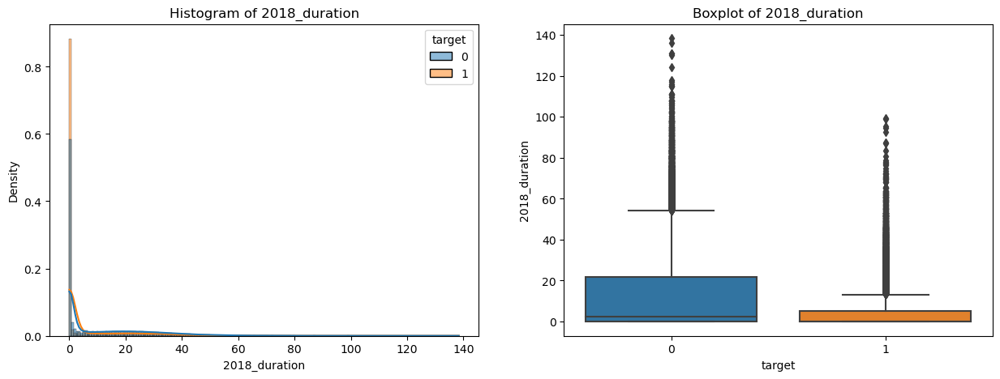

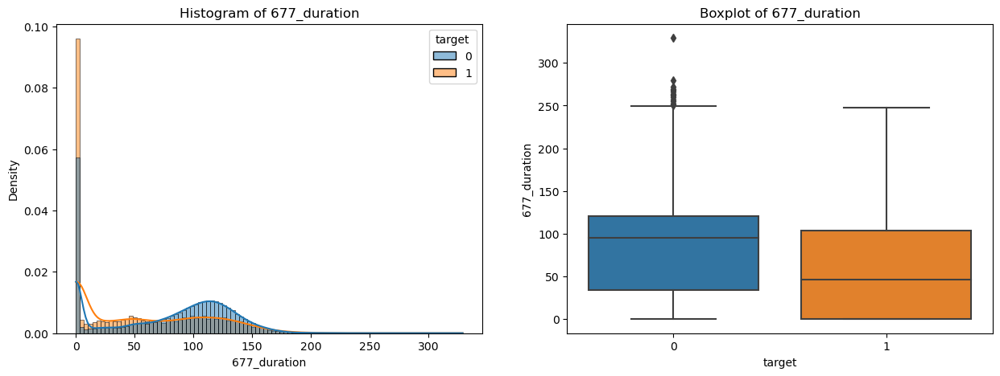

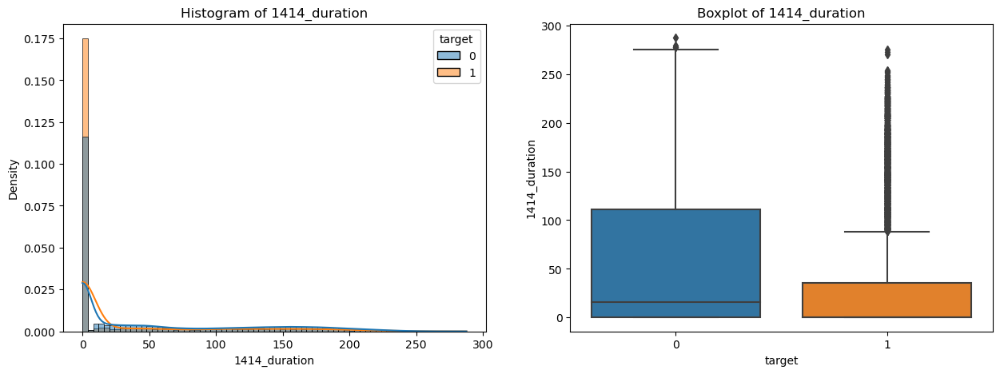

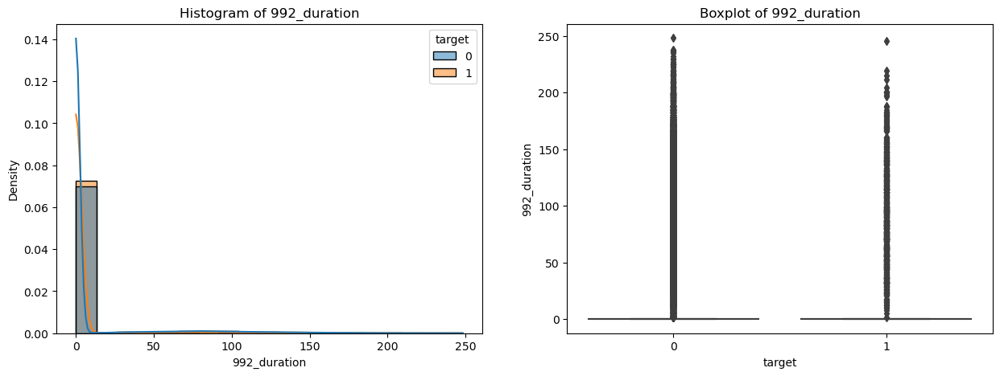

In [19]:
numerical_features = X_train.select_dtypes(include=[np.number]).columns

for feature in numerical_features:
    plt.figure(figsize=(15, 5))
    
    # Гістограма
    plt.subplot(1, 2, 1)
    sns.histplot(data=df_train_fe, x=feature, hue='target', kde=True, stat='density', common_norm=False)
    plt.title(f'Histogram of {feature}')
    
    # Boxplot
    plt.subplot(1, 2, 2)
    sns.boxplot(data=df_train_fe, x='target', y=feature)
    plt.title(f'Boxplot of {feature}')
    
    plt.show()

## Розподіли значень, гістограми інший масштаб, violin

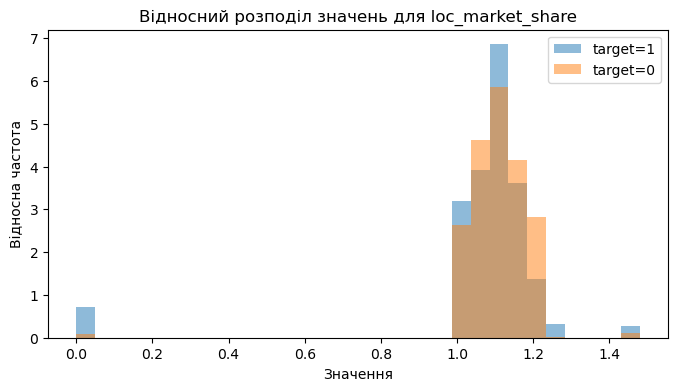

loc_market_share


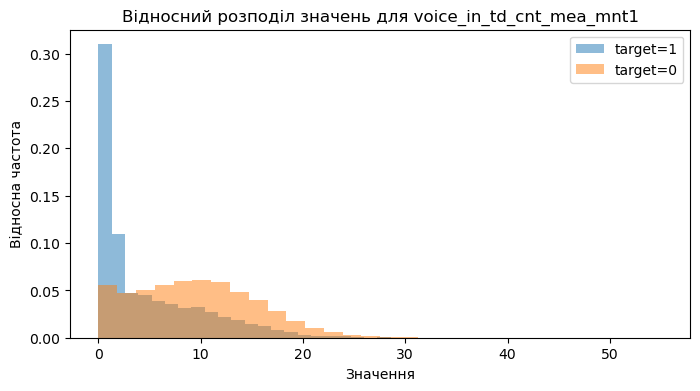

voice_in_td_cnt_mea_mnt1


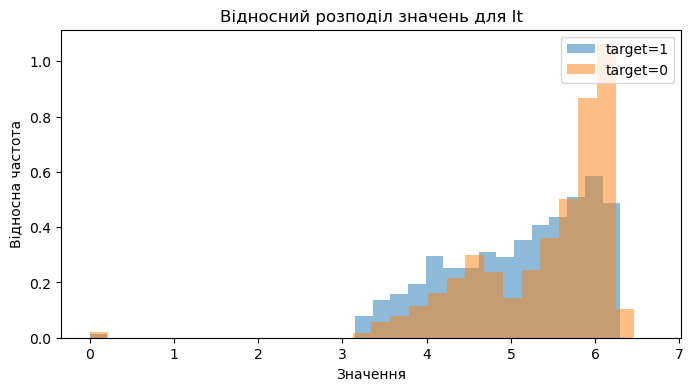

lt


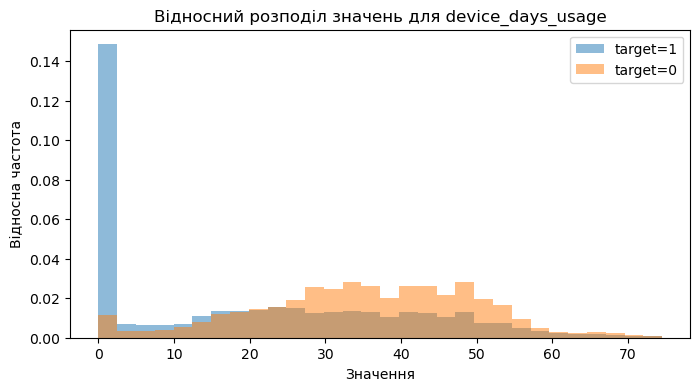

device_days_usage


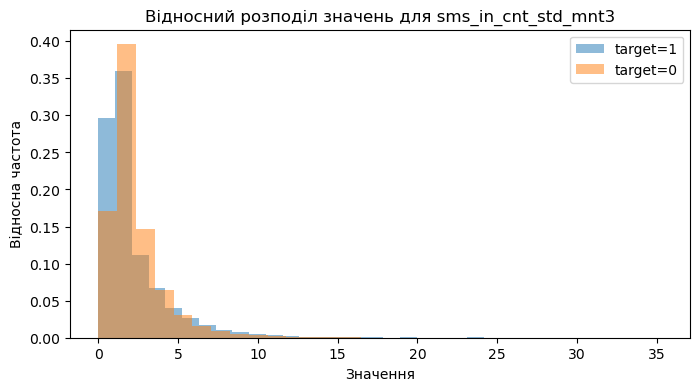

sms_in_cnt_std_mnt3


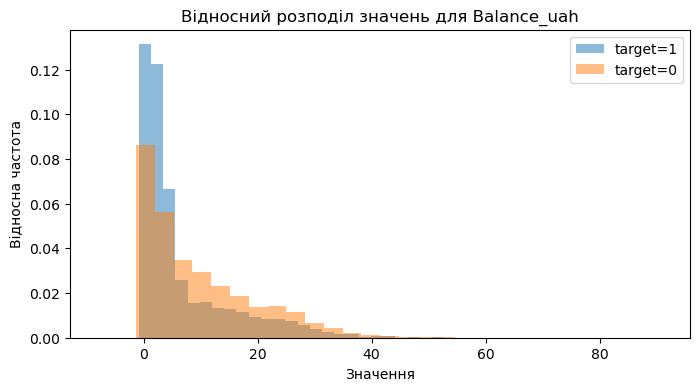

Balance_uah


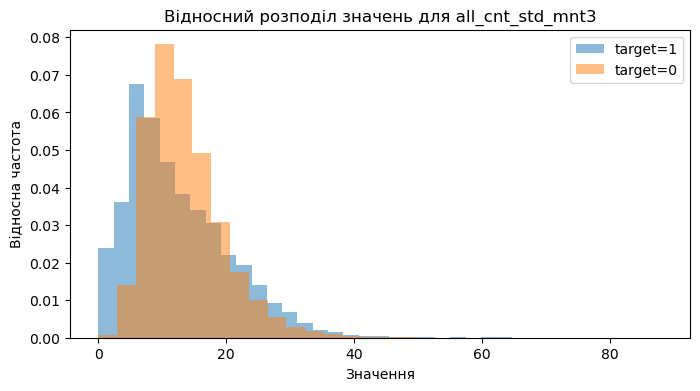

all_cnt_std_mnt3


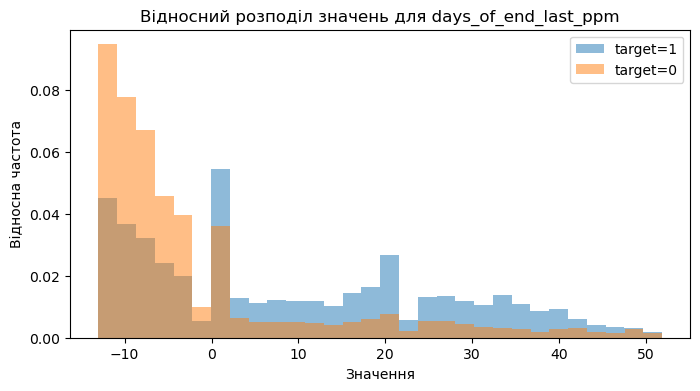

days_of_end_last_ppm


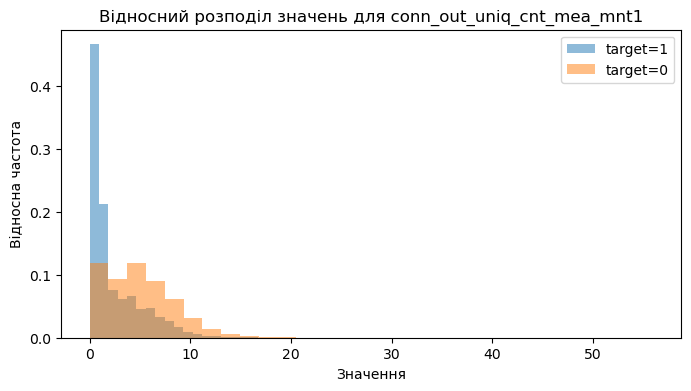

conn_out_uniq_cnt_mea_mnt1


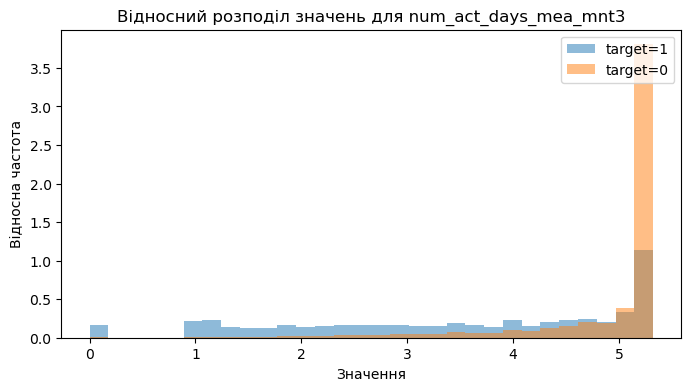

num_act_days_mea_mnt3


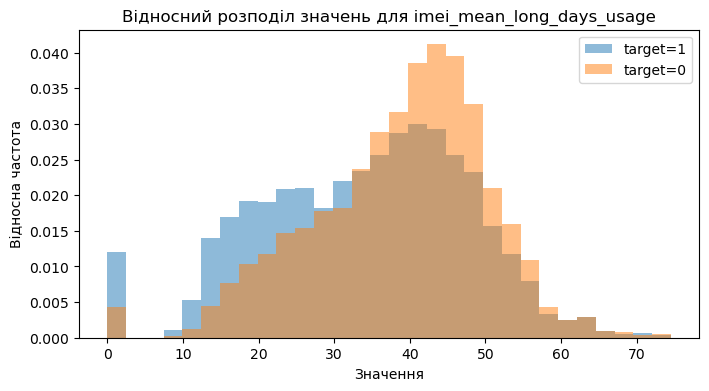

imei_mean_long_days_usage


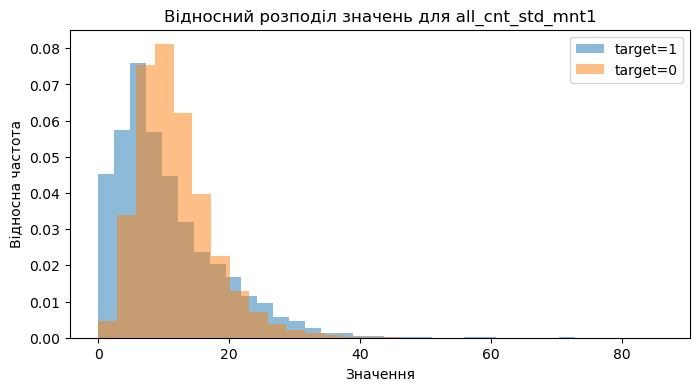

all_cnt_std_mnt1


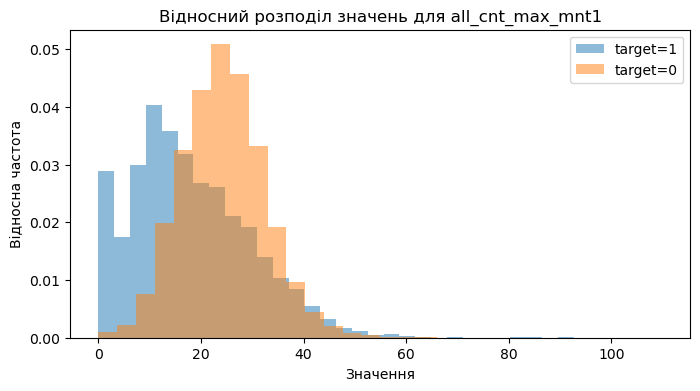

all_cnt_max_mnt1


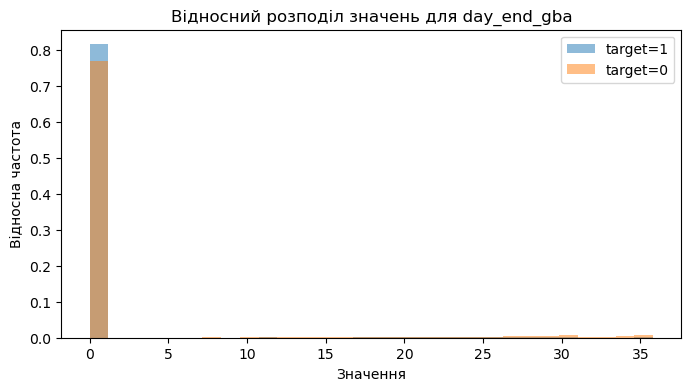

day_end_gba


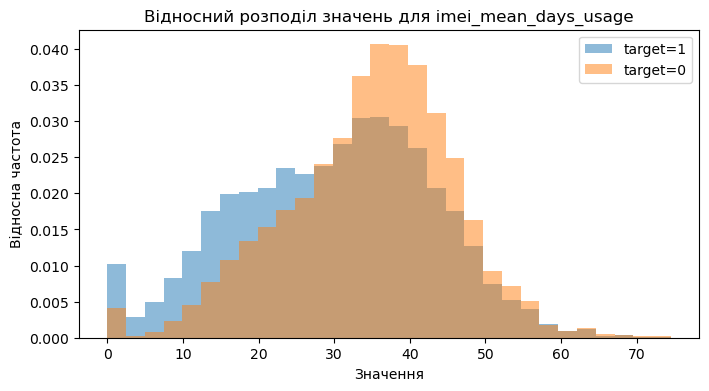

imei_mean_days_usage


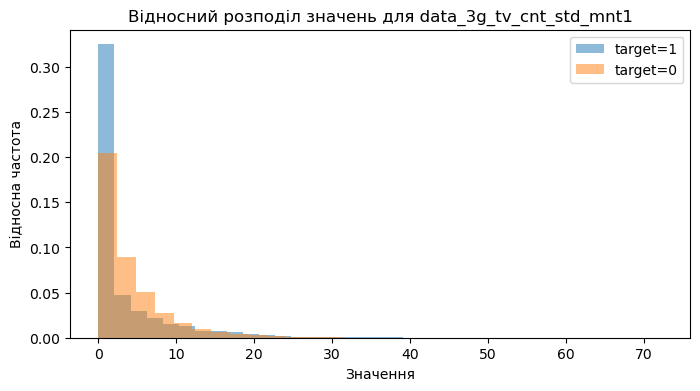

data_3g_tv_cnt_std_mnt1


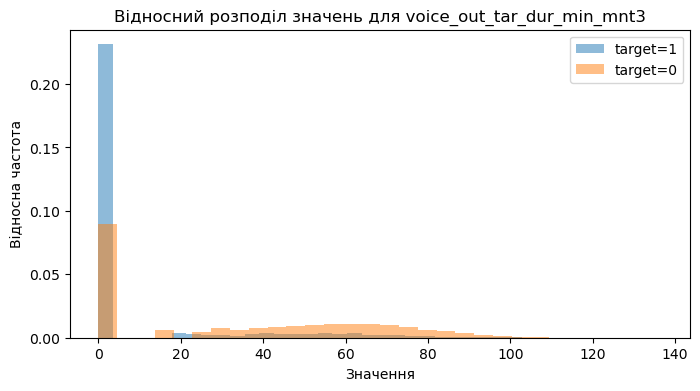

voice_out_tar_dur_min_mnt3


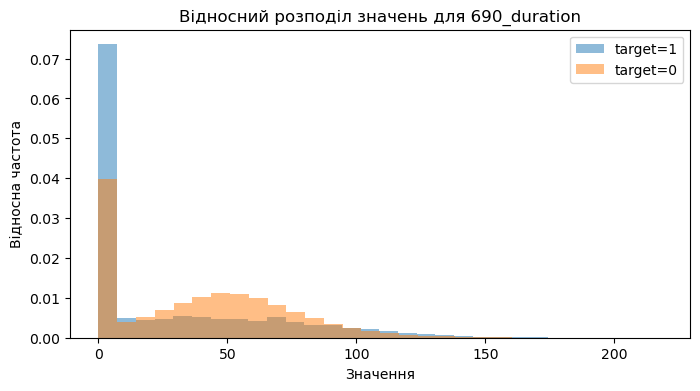

690_duration


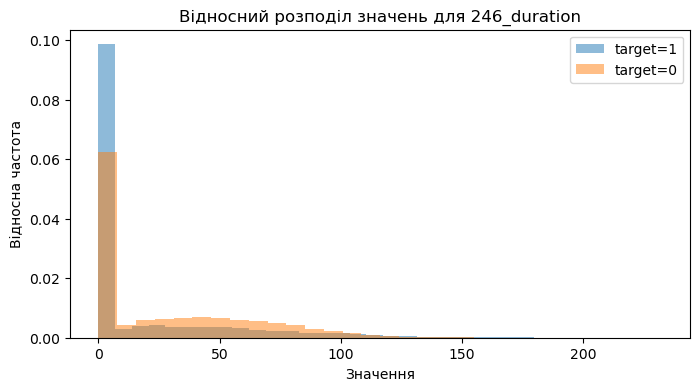

246_duration


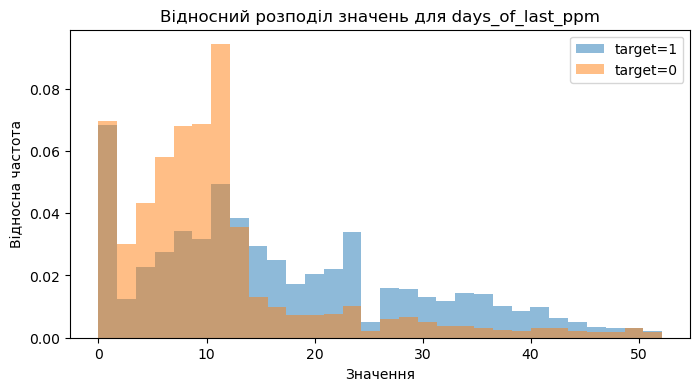

days_of_last_ppm


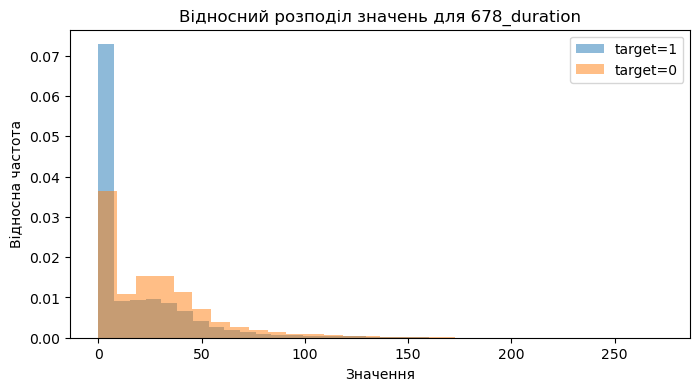

678_duration


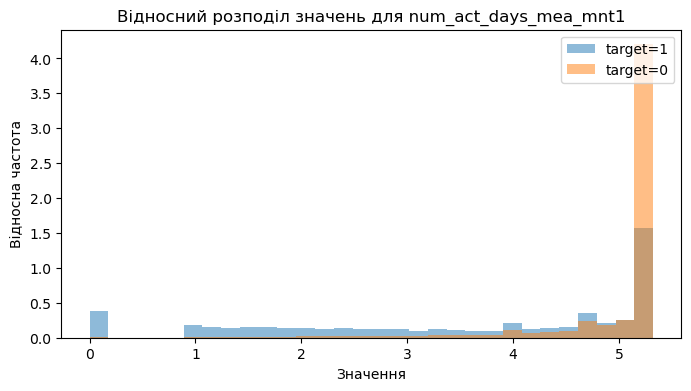

num_act_days_mea_mnt1


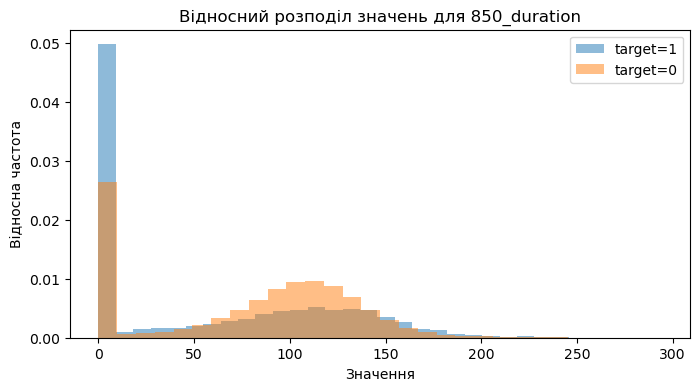

850_duration


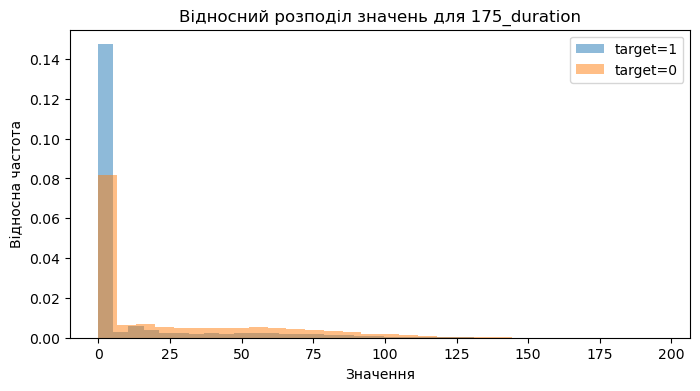

175_duration


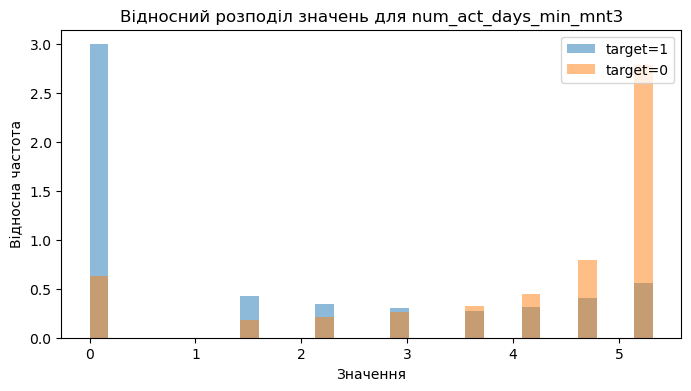

num_act_days_min_mnt3


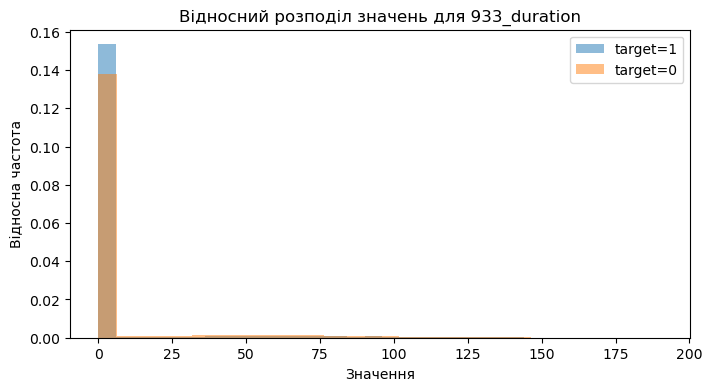

933_duration


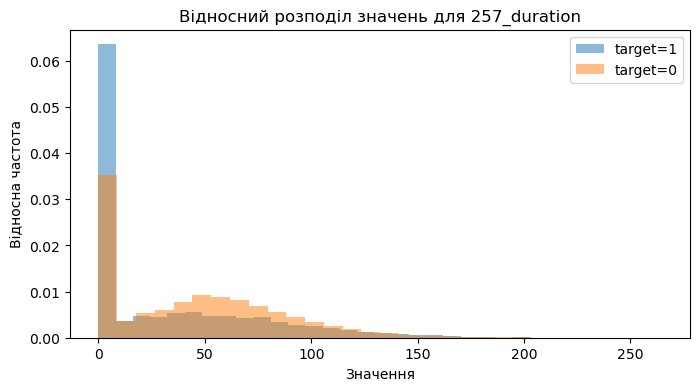

257_duration


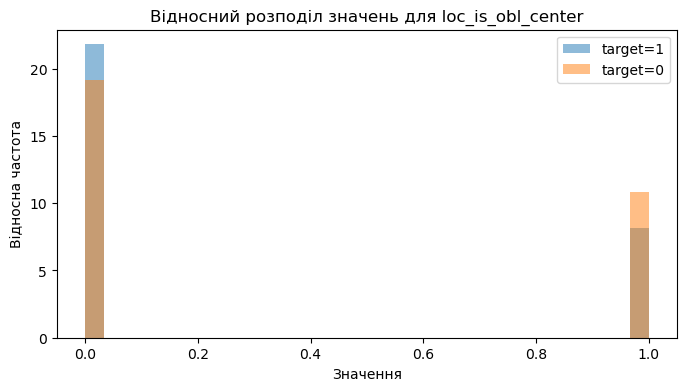

loc_is_obl_center


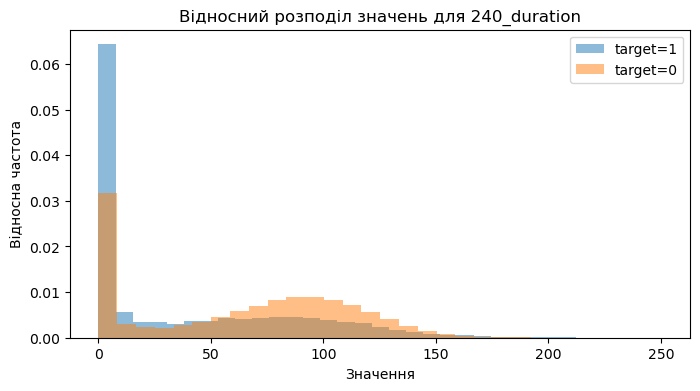

240_duration


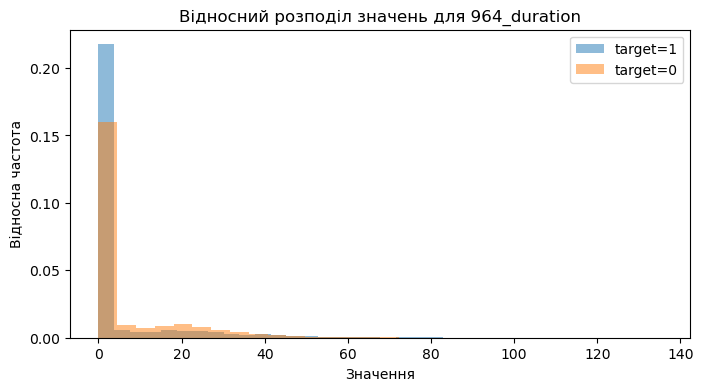

964_duration


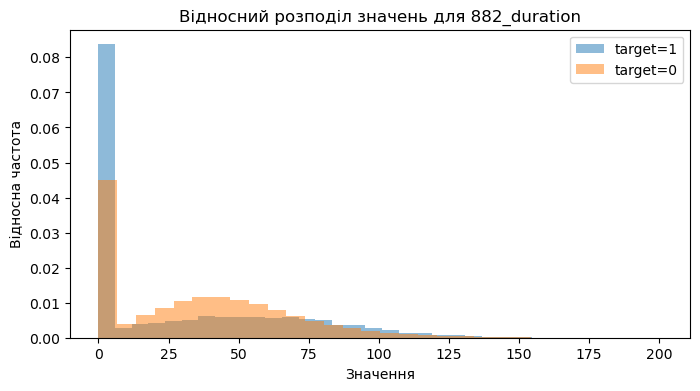

882_duration


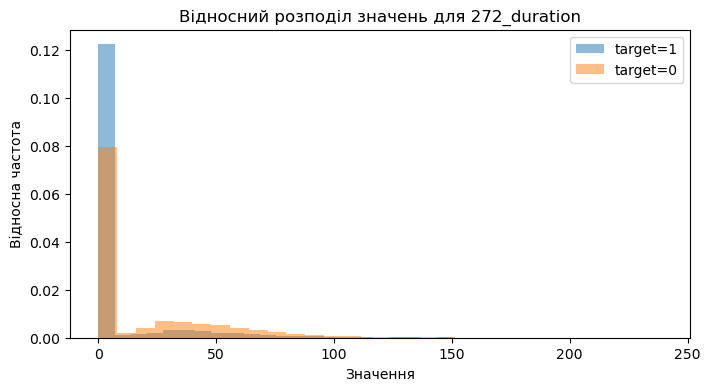

272_duration


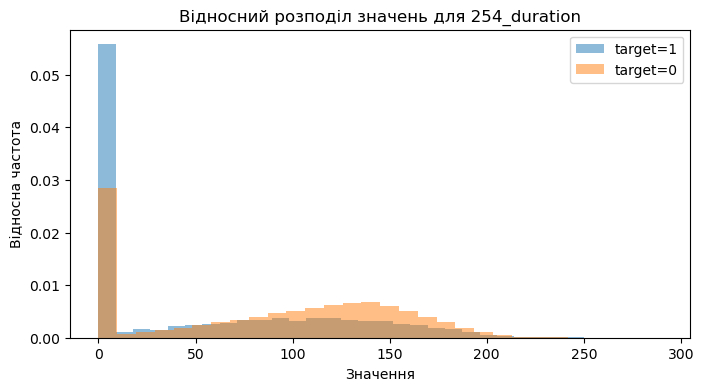

254_duration


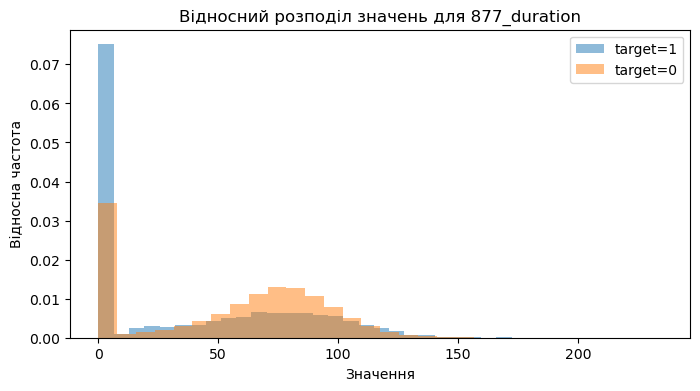

877_duration


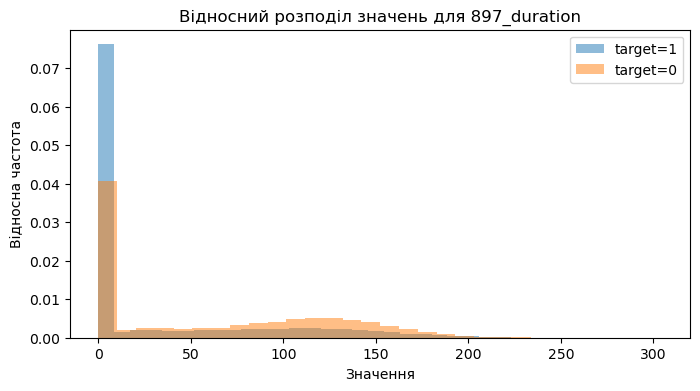

897_duration


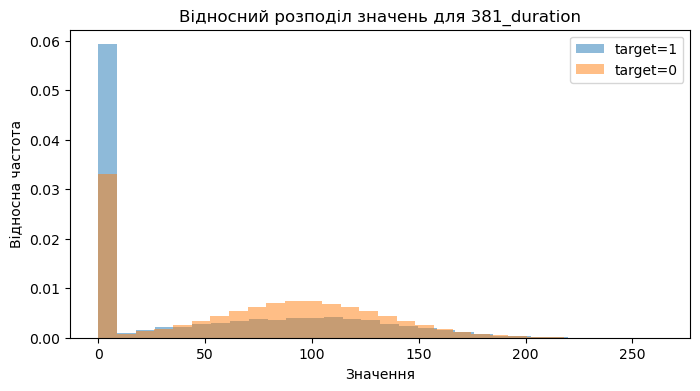

381_duration


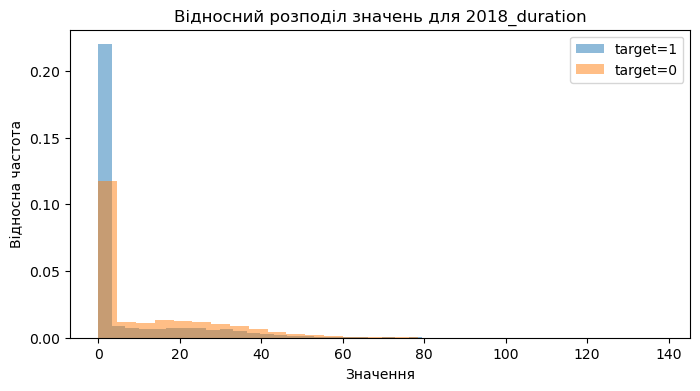

2018_duration


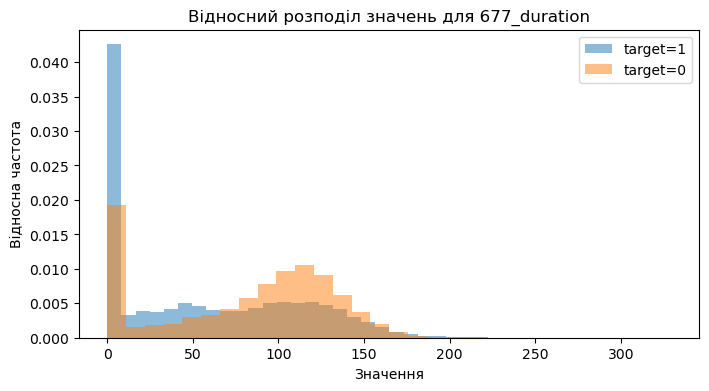

677_duration


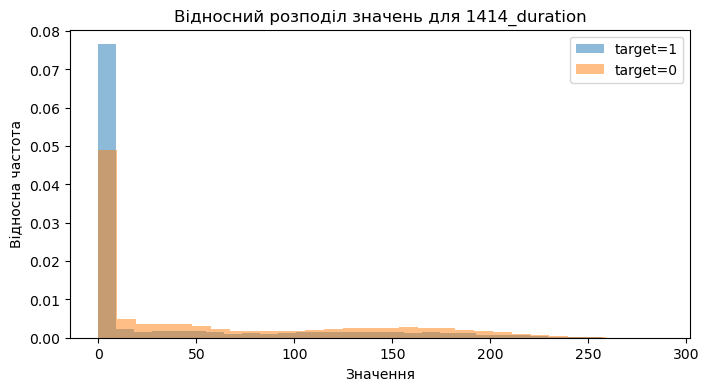

1414_duration


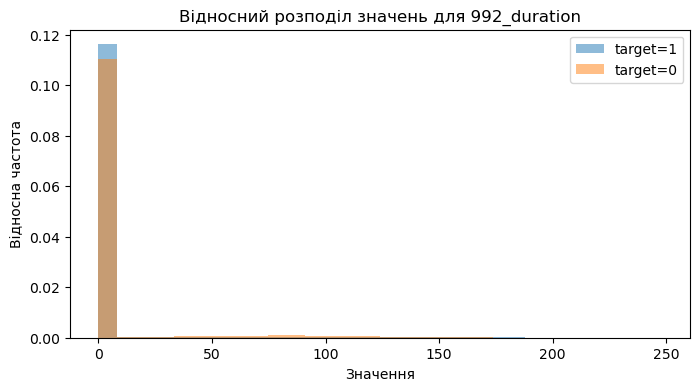

992_duration


In [22]:
df_target_1 = df_train_fe[df_train_fe['target'] == 1]
df_target_0 = df_train_fe[df_train_fe['target'] == 0]

features = [col for col in df_train_fe.columns if col != 'target']

for feature in features:
    plt.figure(figsize=(8, 4))
    
    plt.hist(df_target_1[feature], bins=30, alpha=0.5, label='target=1', density=True)
    plt.hist(df_target_0[feature], bins=30, alpha=0.5, label='target=0', density=True)
    
    plt.title(f'Відносний розподіл значень для {feature}')
    plt.xlabel('Значення')
    plt.ylabel('Відносна частота')
    plt.legend(loc='upper right')
    
    plt.show()
    print(feature)

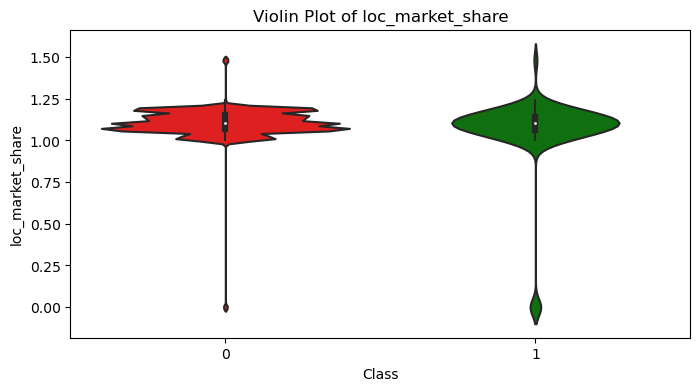

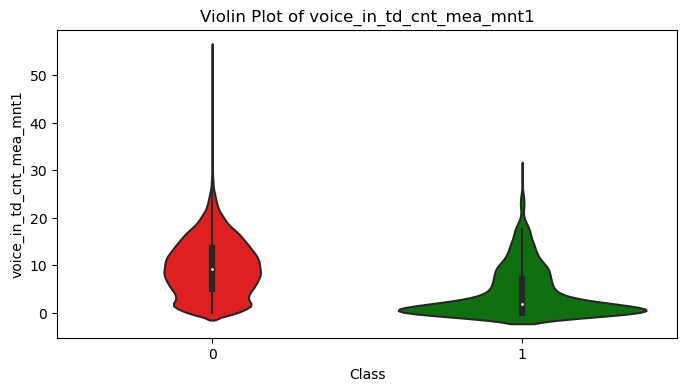

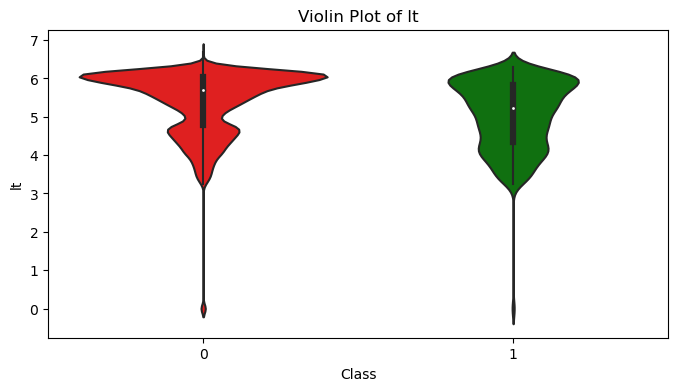

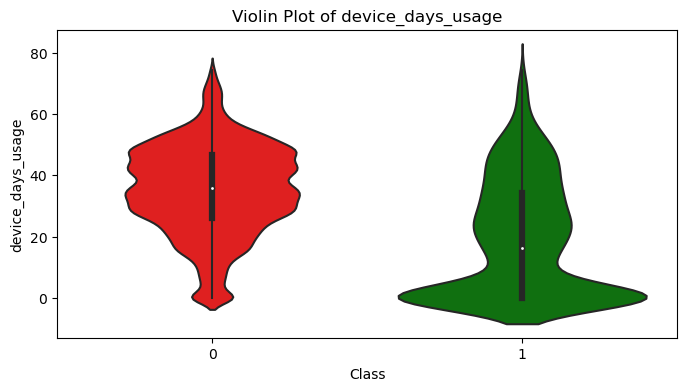

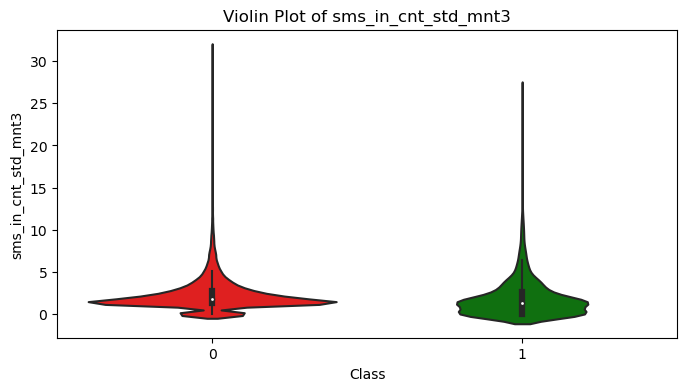

...

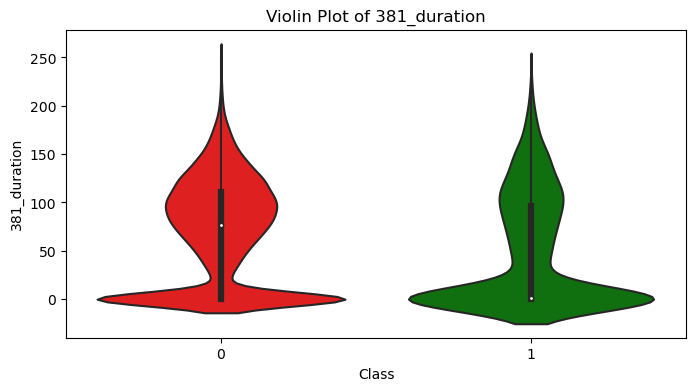

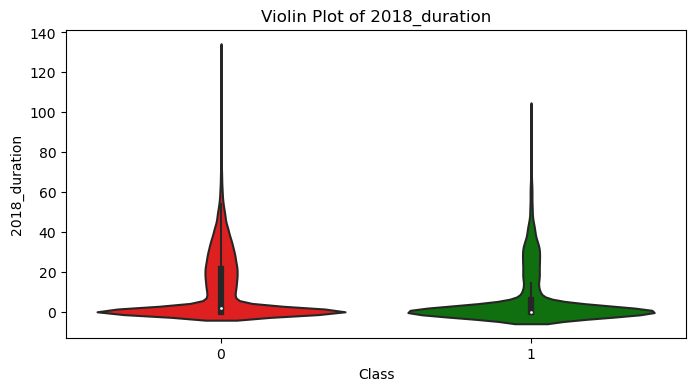

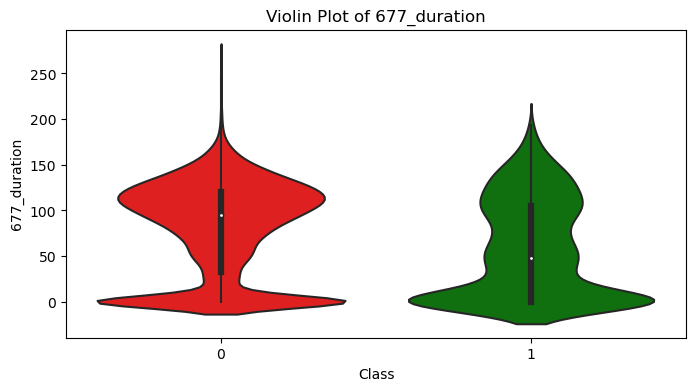

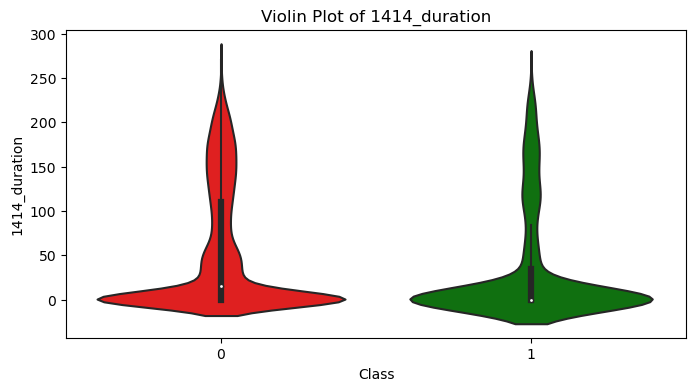

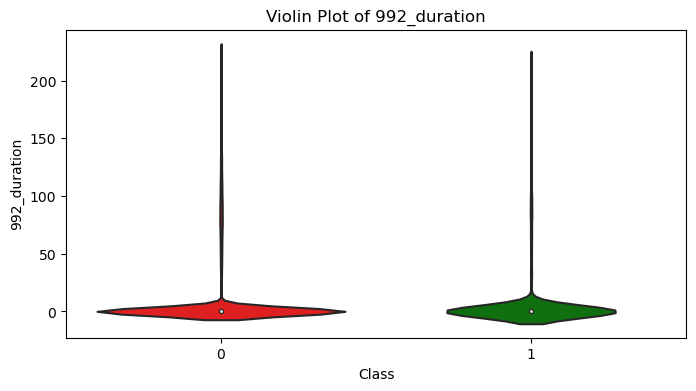

In [48]:
for feature in features:
    plt.figure(figsize=(8, 4))
    
    sns.violinplot(x=y_val, y=X_val[feature], palette={0: 'red', 1: 'green'}, split=True)
    
    plt.title(f'Violin Plot of {feature}')
    plt.xlabel('Class')
    plt.ylabel(feature)
    plt.show()

## Pairplots 

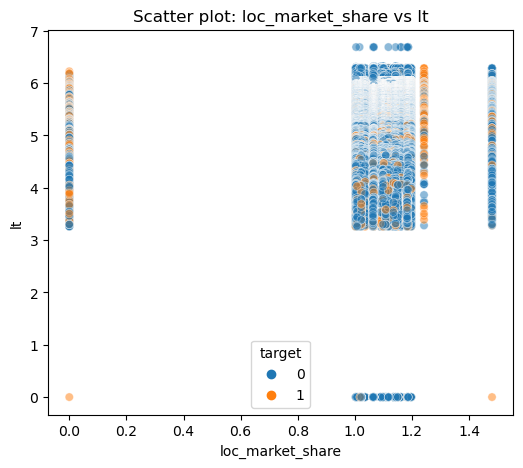

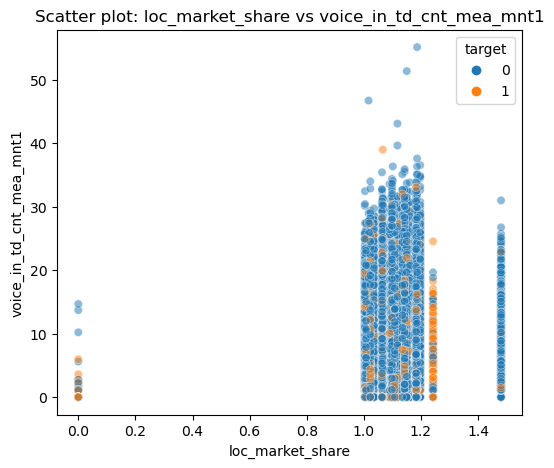

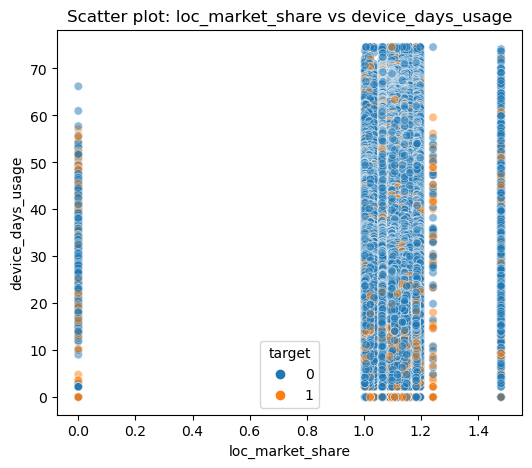

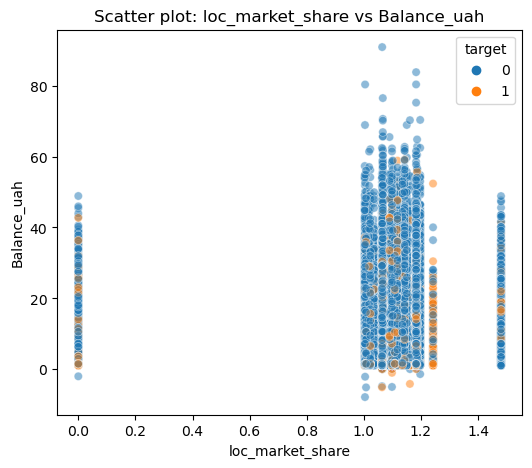

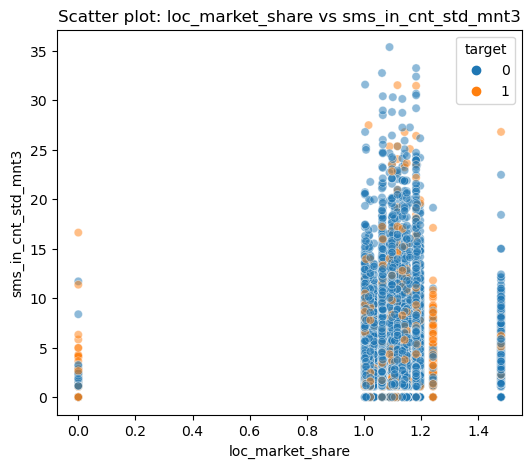

...

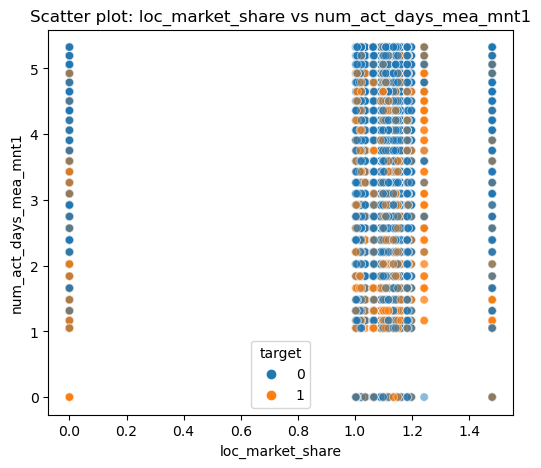

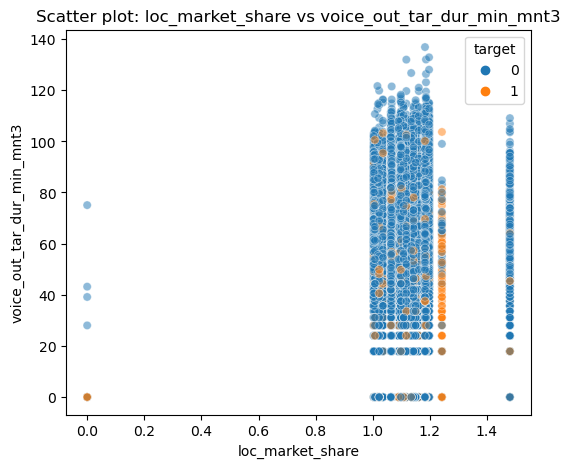

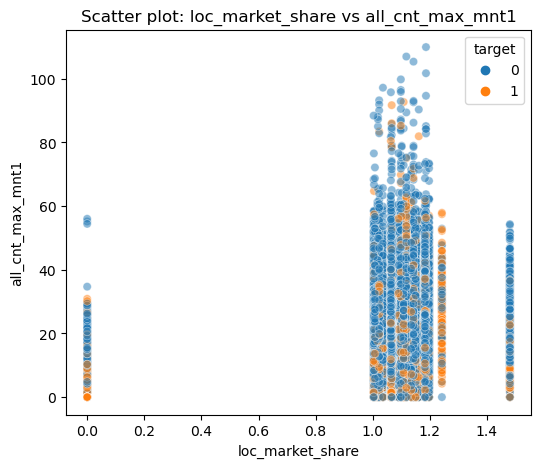

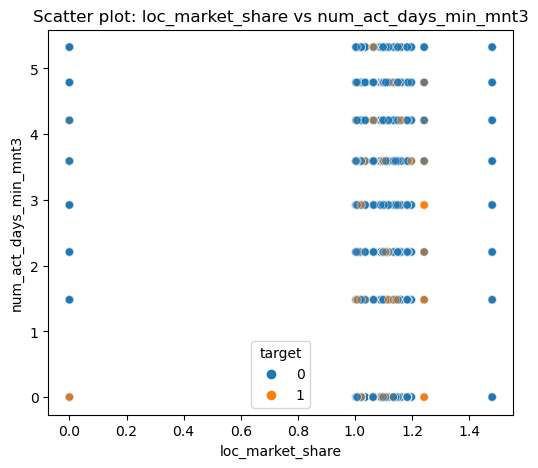

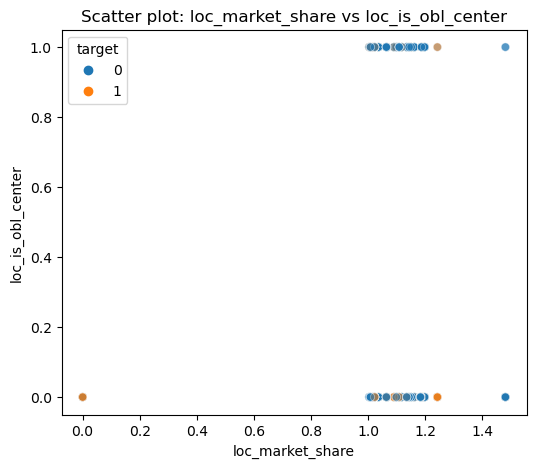

In [21]:
pairs = [
    ("loc_market_share", "lt"),
    ("loc_market_share", "voice_in_td_cnt_mea_mnt1"),
    ("loc_market_share", "device_days_usage"),
    ("loc_market_share", "Balance_uah"),
    ("loc_market_share", "sms_in_cnt_std_mnt3"),
    ("loc_market_share", "all_cnt_std_mnt3"),
    ("loc_market_share", "days_of_end_last_ppm"),
    ("loc_market_share", "imei_mean_days_usage"),
    ("loc_market_share", "num_act_days_mea_mnt3"),
    ("loc_market_share", "conn_out_uniq_cnt_mea_mnt1"),
    ("loc_market_share", "day_end_gba"),
    ("loc_market_share", "all_cnt_std_mnt1"),
    ("loc_market_share", "imei_mean_long_days_usage"),
    ("loc_market_share", "days_of_last_ppm"),
    ("loc_market_share", "data_3g_tv_cnt_std_mnt1"),
    ("loc_market_share", "num_act_days_mea_mnt1"),
    ("loc_market_share", "voice_out_tar_dur_min_mnt3"),
    ("loc_market_share", "all_cnt_max_mnt1"),
    ("loc_market_share", "num_act_days_min_mnt3"),
    ("loc_market_share", "loc_is_obl_center")
]

for feat1, feat2 in pairs:
    plt.figure(figsize=(6, 5)) 
    sns.scatterplot(x=feat1, y=feat2, hue='target', data=df_train_fe, alpha=0.5)
    plt.title(f'Scatter plot: {feat1} vs {feat2}')
    plt.show()

C:\Users\shnurko\AppData\Local\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\shnurko\AppData\Local\Temp\ipykernel_14096\3264459841.py:6: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


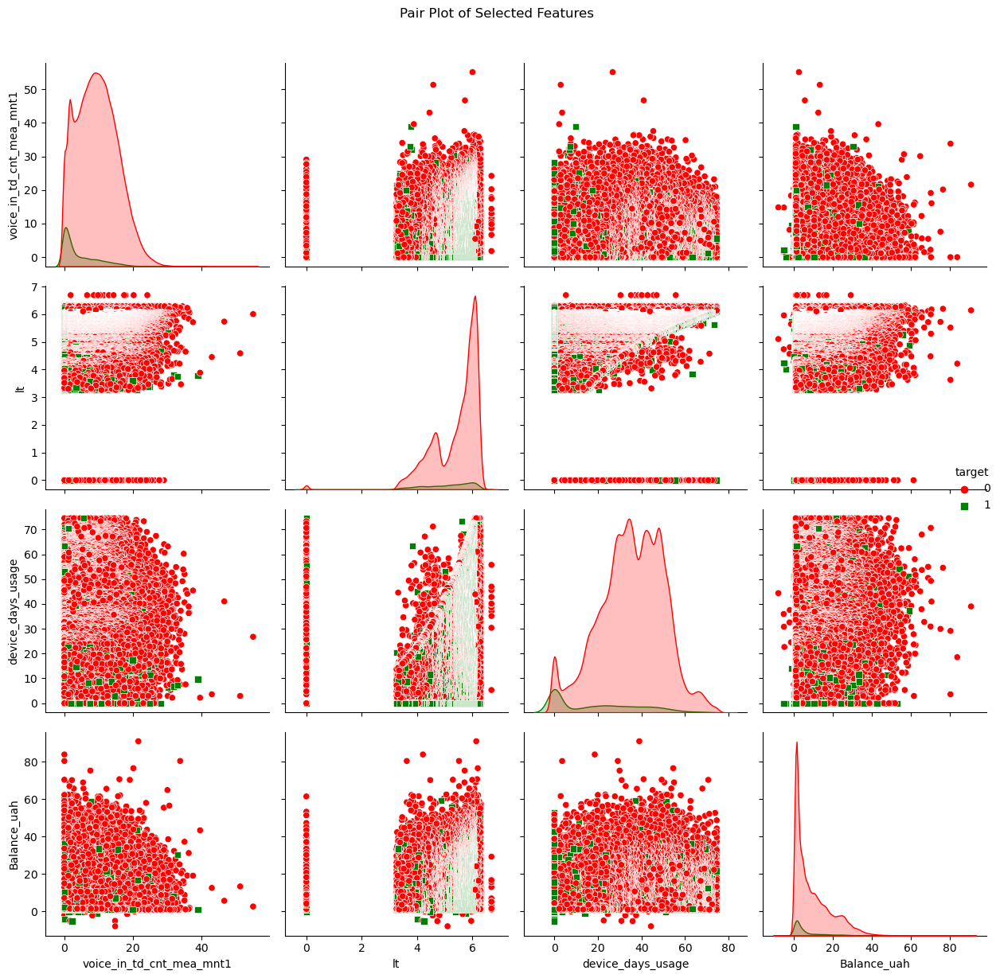

In [44]:
selected_features = ['voice_in_td_cnt_mea_mnt1', 'lt',
       'device_days_usage', 'Balance_uah']

pairplot = sns.pairplot(df_train_fe, vars=selected_features, hue='target', palette={0: 'red', 1: 'green'}, markers=["o", "s"], height=3)
pairplot.fig.suptitle('Pair Plot of Selected Features', y=1.02)
plt.tight_layout()
plt.show()

## Розподіл ймовірностей scatterplots

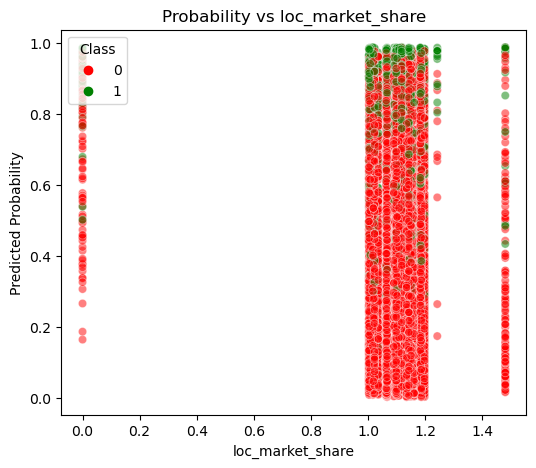

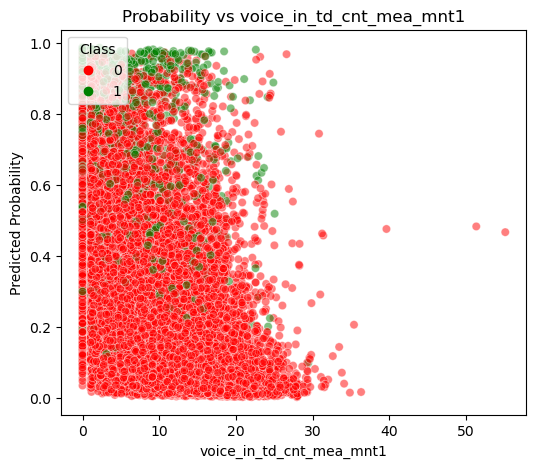

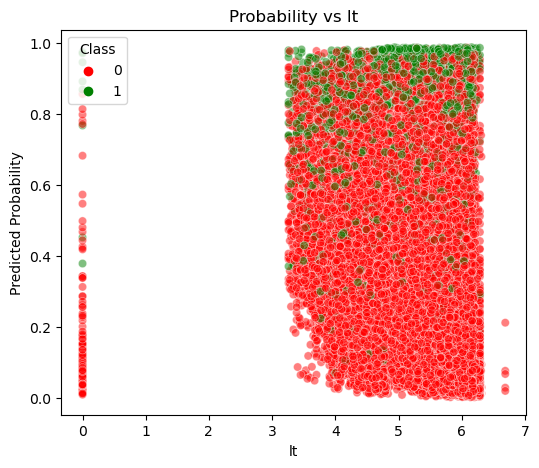

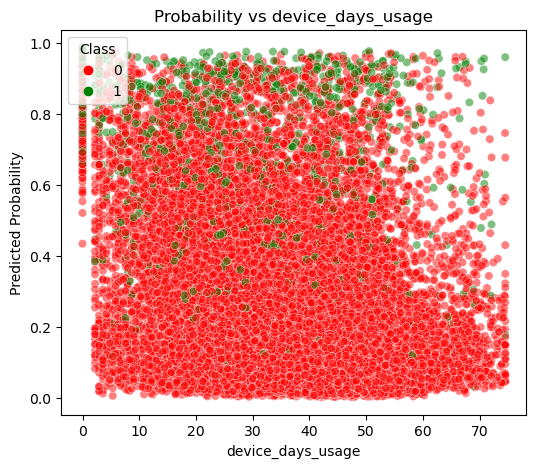

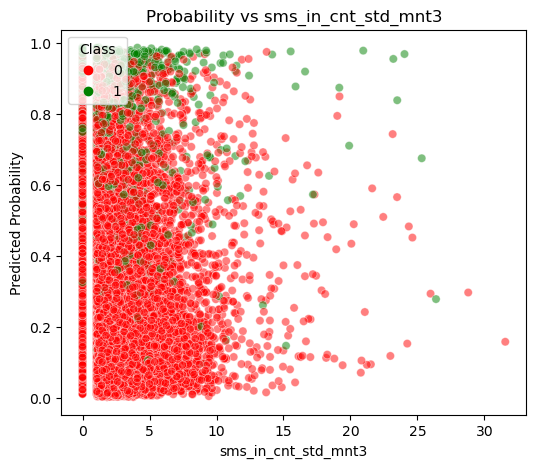

...

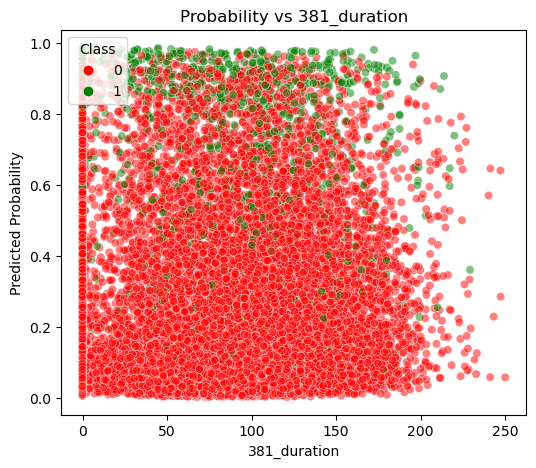

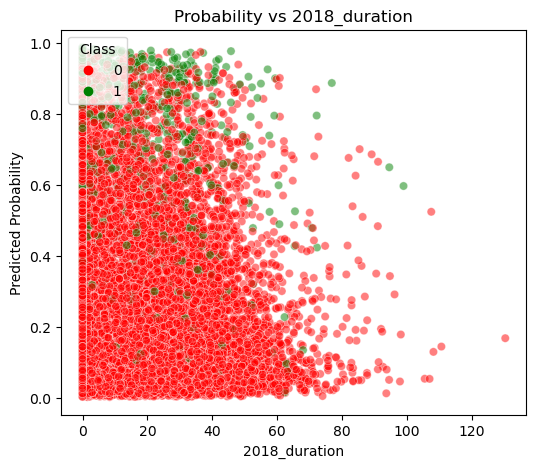

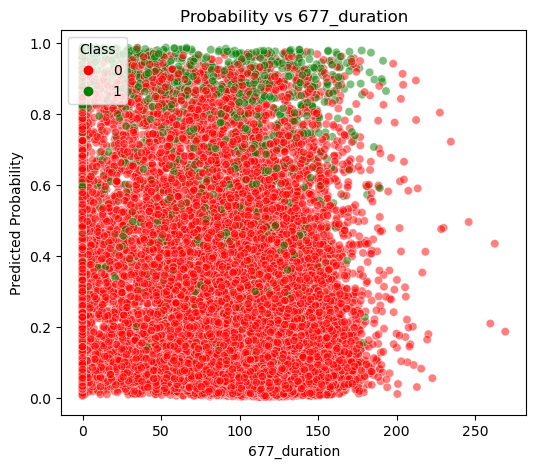

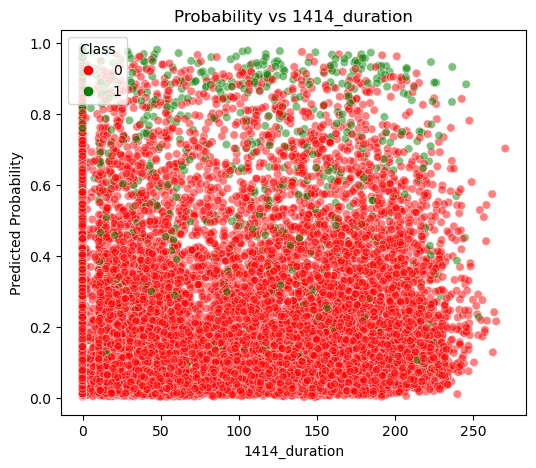

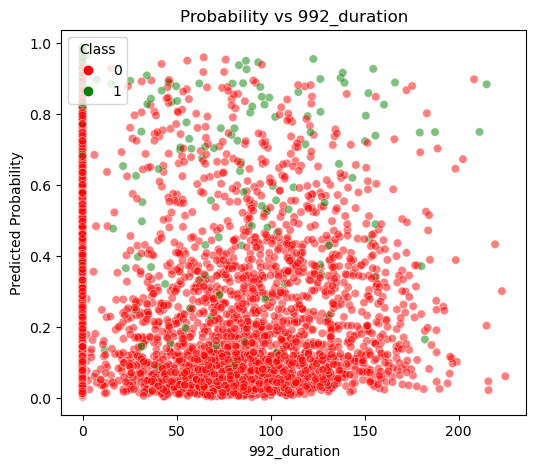

In [34]:
for feature in features:
    plt.figure(figsize=(6, 5))

    sns.scatterplot(x=X_val[feature], y=y_val_pred_prob, hue=y_val, palette={0: 'red', 1: 'green'}, alpha=0.5)

    plt.title(f'Probability vs {feature}')
    plt.xlabel(feature)
    plt.ylabel('Predicted Probability')
    plt.legend(title='Class', loc='upper left')
    plt.show()

## Висновки